# Travel Package Purchase Prediction for `Visit With Us` company

## Problem Statement

The Policy Maker of the company wants to enable and establish a viable business model to expand the customer base.

A viable business model is a central concept that helps you to understand the existing ways of doing the business and how to change the ways for the benefit of the tourism sector.

One of the ways to expand the customer base is to introduce a new offering of packages.

Currently, there are 5 types of packages the company is offering - Basic, Standard, Deluxe, Super Deluxe, King. Looking at the data of the last year, we observed that 18% of the customers purchased the packages.

However, the marketing cost was quite high because customers were contacted at random without looking at the available information.

The company is now planning to launch a new product i.e. Wellness Tourism Package. Wellness Tourism is defined as Travel that allows the traveler to maintain, enhance or kick-start a healthy lifestyle, and support or increase one's sense of well-being.

However, this time company wants to harness the available data of existing and potential customers to make the marketing expenditure more efficient.

You as a Data Scientist at "Visit with us" travel company have to analyze the customers' data and information to provide recommendations to the Policy Maker and Marketing Team and also build a model to predict the potential customer who is going to purchase the newly introduced travel package.


### Objective
To predict which customer is more likely to purchase the newly introduced travel package.


### 1) Install all the necessary Python Packages & Libraries 

In [191]:
### Uncomment below pip3 install command to install xgboost if already not installed. 
#!pip3 install xgboost 
#!pip install lightgbm
#!pip install mlxtend

import pandas as pd
import numpy as np
from sklearn import metrics
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
from sklearn.model_selection import train_test_split

from sklearn import metrics

#Importing all classifiers required for building Models
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

# To get diferent metric scores
from sklearn import metrics
from sklearn.metrics import f1_score,accuracy_score, recall_score, precision_score, roc_auc_score, roc_curve, confusion_matrix, precision_recall_curve

# To find HyerParameter for the Decision Tree
from sklearn.model_selection import GridSearchCV

#Import packages for Stacking
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor
from mlxtend.regressor import StackingCVRegressor
from sklearn.svm import SVR
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

### 2) Load the customer dataset and reading data into a dataset

In [2]:
datasetName = "Tourism.csv"
customerData = pd.read_csv(datasetName)
customerData.head(10)

,CustomerID,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
0,200000,1,41.0,Self Enquiry,3,6.0,Salaried,Female,3,3.0,Deluxe,3.0,Single,1.0,1,2,1,0.0,Manager,20993.0
1,200001,0,49.0,Company Invited,1,14.0,Salaried,Male,3,4.0,Deluxe,4.0,Divorced,2.0,0,3,1,2.0,Manager,20130.0
2,200002,1,37.0,Self Enquiry,1,8.0,Free Lancer,Male,3,4.0,Basic,3.0,Single,7.0,1,3,0,0.0,Executive,17090.0
3,200003,0,33.0,Company Invited,1,9.0,Salaried,Female,2,3.0,Basic,3.0,Divorced,2.0,1,5,1,1.0,Executive,17909.0
4,200004,0,NaN,Self Enquiry,1,8.0,Small Business,Male,2,3.0,Basic,4.0,Divorced,1.0,0,5,1,0.0,Executive,18468.0
5,200005,0,32.0,Company Invited,1,8.0,Salaried,Male,3,3.0,Basic,3.0,Single,1.0,0,5,1,1.0,Executive,18068.0
6,200006,0,59.0,Self Enquiry,1,9.0,Small Business,Female,2,2.0,Basic,5.0,Divorced,5.0,1,2,1,1.0,Executive,17670.0
7,200007,0,30.0,Self Enquiry,1,30.0,Salaried,Male,3,3.0,Basic,3.0,Married,2.0,0,2,0,1.0,Executive,17693.0
8,200008,0,38.0,Company Invited,1,29.0,Salaried,Male,2,4.0,Standard,3.0,Unmarried,1.0,0,3,0,0.0,Senior Manager,24526.0
9,200009,0,36.0,Self Enquiry,1,33.0,Small Business,Male,3,3.0,Deluxe,3.0,Divorced,7.0,0,3,1,0.0,Manager,20237.0


#### Shape of the Loan DataSet

In [3]:
customerData.shape

(4888, 20)

There are `4888` Customer records in the dataset each with `20` features. 

#### Check if any columns have Null Value 

In [4]:
customerData.isnull().any()

CustomerID                  False
ProdTaken                   False
Age                          True
TypeofContact                True
CityTier                    False
DurationOfPitch              True
Occupation                  False
Gender                      False
NumberOfPersonVisiting      False
NumberOfFollowups            True
ProductPitched              False
PreferredPropertyStar        True
MaritalStatus               False
NumberOfTrips                True
Passport                    False
PitchSatisfactionScore      False
OwnCar                      False
NumberOfChildrenVisiting     True
Designation                 False
MonthlyIncome                True
dtype: bool

The dataset provided has null values for lot of columns. We should treat the missingess before proceeding further. 

#### Checking for duplicates 

In [5]:

print(
    f"There are total {customerData.duplicated().sum()} duplicate entries in the dataset provided"
)

There are total 0 duplicate entries in the dataset provided


**Check the data types of the columns for the dataset.**

In [6]:
customerData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4888 entries, 0 to 4887
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CustomerID                4888 non-null   int64  
 1   ProdTaken                 4888 non-null   int64  
 2   Age                       4662 non-null   float64
 3   TypeofContact             4863 non-null   object 
 4   CityTier                  4888 non-null   int64  
 5   DurationOfPitch           4637 non-null   float64
 6   Occupation                4888 non-null   object 
 7   Gender                    4888 non-null   object 
 8   NumberOfPersonVisiting    4888 non-null   int64  
 9   NumberOfFollowups         4843 non-null   float64
 10  ProductPitched            4888 non-null   object 
 11  PreferredPropertyStar     4862 non-null   float64
 12  MaritalStatus             4888 non-null   object 
 13  NumberOfTrips             4748 non-null   float64
 14  Passport

In [7]:
customerData.nunique()

CustomerID                  4888
ProdTaken                      2
Age                           44
TypeofContact                  2
CityTier                       3
DurationOfPitch               34
Occupation                     4
Gender                         3
NumberOfPersonVisiting         5
NumberOfFollowups              6
ProductPitched                 5
PreferredPropertyStar          3
MaritalStatus                  4
NumberOfTrips                 12
Passport                       2
PitchSatisfactionScore         5
OwnCar                         2
NumberOfChildrenVisiting       4
Designation                    5
MonthlyIncome               2475
dtype: int64

There are columns with numeric values (int & float) and there are quite a few columns with String values. 

**Summary of the dataset**

In [8]:
customerData.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
CustomerID,4888.0,NaN,NaN,NaN,202443.5,1411.188388,200000.0,201221.75,202443.5,203665.25,204887.0
ProdTaken,4888.0,NaN,NaN,NaN,0.188216,0.390925,0.0,0.0,0.0,0.0,1.0
Age,4662.0,NaN,NaN,NaN,37.622265,9.316387,18.0,31.0,36.0,44.0,61.0
TypeofContact,4863,2,Self Enquiry,3444,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CityTier,4888.0,NaN,NaN,NaN,1.654255,0.916583,1.0,1.0,1.0,3.0,3.0
DurationOfPitch,4637.0,NaN,NaN,NaN,15.490835,8.519643,5.0,9.0,13.0,20.0,127.0
Occupation,4888,4,Salaried,2368,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gender,4888,3,Male,2916,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberOfPersonVisiting,4888.0,NaN,NaN,NaN,2.905074,0.724891,1.0,2.0,3.0,3.0,5.0
NumberOfFollowups,4843.0,NaN,NaN,NaN,3.708445,1.002509,1.0,3.0,4.0,4.0,6.0


**Observations based on the statistics above -**

1) There are no missing or null values in Target Variable `ProdTaken` which stands for if customer has purchase the product.

2) `Age` column has 226 missing values. We may replace missing values with the mean Age of their respective Gender. Customer age range from 18 to 61 years, with mean of 37.62 (which might change after treating missing)

3) `TypeofContact` has 25 missing values. ***Self Enquiry*** is the top value with 3444 frequency. Meaning out of 4888 custoemrs, 3444 customers Self Enquired for the travel product. 

4) `CityTier` has no missing or null values. All the customers in the data set belong to Tier 1, Tier 2 or Tier 3 cities. We will get more insights on the distribution of customers in the cities in EDA. 

5) `DurationOfPitch` there are some missing values (257) in the customer dataset. We should consider replacing missing value with mean. The lowest value is 5 and highest is 127. So clearly there's outlier and skenewss. 

6) `Occupation` data is complete as there are no missing values. Most customers(2368) are Salaried as seen above. 

7) `Gender` data is also complete, however there seems to be 3 unique values. Will need to dig out more to find out why there are 3 unique values for Gender.

8) `NumberOfPersonVisiting` data is complete with no missing values, and ranges from 1 to 5 people with mean of 2.9.

9) `NumberOfFollowups` data contains some missing values (54 records), which we should consider replacing with mean. Number Of Follow up ranges from 1 to 6 with 3.7 as average. 

10) `ProductPitched` data is complete and contain no missing values. There are 5 unique values with Basic has highest frequency. 

11) `PreferredPropertyStar` has 28 missing values, which could be replaced with mean. Minimum star of 3 and max of 5.

12) `MaritalStatus` All customers in the dataset have reported their marital status. There are 4 unique Marital statuses which needs to be investigated further. 

13) `NumberOfTrips` 140 customers don't have NumberOfTrips reported. Needs to treat missigness and outliers as there are customers with trips ranging from 1 to 22 with a mean of 3.23. Since mean is so low, we should expect outliers on the upper side. 

14) `Passport` data is complete and all customer have reported whether they have passport or not. 

15) `PitchSatisfactionScore` is complete and all customers are have provided their scores. It ranges from 1 to 5 and mean score is 3.07

16) `OwnCar` All customers have reported about their car ownership.

17) `NumberOfChildrenVisiting` have some missing values (66 customers haven't reported). The data range from 0 to a max of 3 children. 

18) `Designation` All customers Designation is mentioned in the dataset. There ar e 5 unique designation values with most customer designated as `Executive` (total 1842 customers)

19) `MonthlyIncome` Has some missing values (233 customers monthly income is missing). We should find an appropriate mean value to replace missing values. Monthly Income ranges from 1000 to 98678 with a mean of 23619.85. Clearly there could be outliers on either sides.

## 3) Preprocessing data 

As part of this step, I will evaluating & treating the **missing values**, **wrong values** of various columns. I consider this important before doing EDA (Univariate & MultiVariate Analysis). 

I will treat outliers, if identified during univariate & multivaritate anlysis after the EDA step. 

**`Gender`**

1) Gender data has no missing values but has 3 unique values. This could indicate wrong value.

2) Check for the wrong values. 

3) Treat the wrong values. 

In [9]:
customerData.Gender.unique()

array(['Female', 'Male', 'Fe Male'], dtype=object)

Clearly "Fe Male" needs to be corrected to "Female". 

In [10]:
customerData["Gender"] = customerData["Gender"].apply(lambda x: 'Female' if x == 'Fe Male' else x)
customerData.Gender.unique()

array(['Female', 'Male'], dtype=object)

`Gender` column of customer dataset is fixed. 

**`Age`**

1) Missing Age of the Male Customers will be replaced with Mean Age of Male Customers. 

2) Missing Age of Female Customers will be replaced with Mean Age of Female Customers. 

In [11]:
## Calculate the Mean Age of Male Customers 

maleMeanAge = customerData[customerData["Gender"] == 'Male'].Age.mean()
print("Mean Age of Male Customers ", maleMeanAge)

## Calculate the Mean Age of Female Customers 

femaleMeanAge = customerData[customerData["Gender"] == 'Female'].Age.mean()
print("Mean Age of Female Customers ", femaleMeanAge)

Mean Age of Male Customers  37.31998556998557
Mean Age of Female Customers  38.06560846560846


In [12]:
## Replace missing values with their respective Means

def getMeanAge(x):
    if (x["Gender"] == 'Male'):
      return maleMeanAge
    else:
      return femaleMeanAge

customerData["Age"] = customerData.apply(lambda x: getMeanAge(x) if np.isnan(x["Age"]) else x["Age"], axis=1)

customerData["Age"].isnull().sum()

0

**`TypeofContact`**

1) TypeofContact has 25 missing values. 

2) There is no apparant way to replace missing values. So lets analyze what values does this column has. 

In [13]:
customerData.TypeofContact.unique()

array(['Self Enquiry', 'Company Invited', nan], dtype=object)

There are only 2 values for TypeofContact. We have 3 ways to treat missing values - 

1) Drop the rows with missing TypeofContact.

2) Insert value of "Other" indicating its different than existing 2 values. 

3) Replace missing value to "Self Enquiry" and "Company Invited" in the same proportions as they exists in the dataset. 

I am selectint **#3** from above as my technique for treating missingness. 


In [14]:
customerData.groupby(["TypeofContact"]).agg(["count"])

,CustomerID,ProdTaken,Age,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,NumberOfChildrenVisiting,Designation,MonthlyIncome
,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count,count
TypeofContact,,,,,,,,,,,,,,,,,,,
Company Invited,1419,1419,1419,1419,1334,1419,1419,1419,1404,1419,1415,1419,1381,1419,1419,1419,1410,1419,1349
Self Enquiry,3444,3444,3444,3444,3303,3444,3444,3444,3414,3444,3422,3444,3342,3444,3444,3444,3387,3444,3306


So the ratio of customer with Self Enquiry & Company Invited is = 3444/1419 == 2.5.

So for the sake of simplicity and to reasonable impute TypeofContact missing value we will impute missing values with Self Enquiry & Company Invited in the ratio of 3:1

Which mean out of 25 columns roughly 1/3 (or 8) rows will get "Company Invited" and remaining 2/3 or (17) will get "Self Enquiry" values. 

So let's right the impute function to treat the missing values. 

In [15]:
selfEnquiryCount = 8
randomState = 0

def getTypeofContact():
    global randomState
    global selfEnquiryCount 
    randomState = randomState + 1
    if ((randomState % 2) == 0) and (selfEnquiryCount > 0):
        selfEnquiryCount = selfEnquiryCount - 1
        return "Self Enquiry"
    else:
        return "Company Invited"

customerData["TypeofContact"] = customerData["TypeofContact"].apply(lambda x: getTypeofContact() if x is np.nan else x)

customerData["TypeofContact"].isnull().sum()    

0

**`DurationOfPitch`**

We will replace the missing values with mean. But before that, lets find out if mean DurationOfPitch for male & female vaires a lot, and if so we will select mean for respective Gender. 

In [16]:
## Calculate the Mean DurationOfPitch for Male Customers 

meanDurationOfPitchMale = customerData[customerData["Gender"] == 'Male'].DurationOfPitch.mean()
print("Mean DurationOfPitch of Male Customers ", meanDurationOfPitchMale)

## Calculate the Mean DurationOfPitch of Female Customers 

meanDurationOfPitchFemale = customerData[customerData["Gender"] == 'Female'].DurationOfPitch.mean()
print("Mean DurationOfPitch of Female Customers ", meanDurationOfPitchFemale)

## Calculate the Mean DurationOfPitch for all Customers 

meanDurationOfPitch = customerData.DurationOfPitch.mean()
print("Mean DurationOfPitch of  Customers ", meanDurationOfPitch)


Mean DurationOfPitch of Male Customers  15.555315315315315
Mean DurationOfPitch of Female Customers  15.394736842105264
Mean DurationOfPitch of  Customers  15.490834591330602


Since there isn't much difference between mean DurationOfPitch for male & female, I am going using overall mean and rounding it to nearset integer. 

In [17]:
customerData["DurationOfPitch"] = customerData["DurationOfPitch"].apply(lambda x: round(meanDurationOfPitch) if np.isnan(x) else x)

customerData["DurationOfPitch"].isnull().sum() 

0

**`NumberOfFollowups`**

We will follow the same techinque as DurationOfPitch. Find the mean by Gender and selecting an appropriate mean to replace missing value

In [18]:
## Calculate the Mean NumberOfFollowups for Male Customers 

meanNumberOfFollowupsMale = customerData[customerData["Gender"] == 'Male'].NumberOfFollowups.mean()
print("Mean NumberOfFollowups of Male Customers ", meanNumberOfFollowupsMale)

## Calculate the Mean NumberOfFollowups of Female Customers 

meanNumberOfFollowupsFemale = customerData[customerData["Gender"] == 'Female'].NumberOfFollowups.mean()
print("Mean NumberOfFollowups of Female Customers ", meanNumberOfFollowupsFemale)

## Calculate the Mean NumberOfFollowups for all Customers 

meanNumberOfFollowups = customerData.NumberOfFollowups.mean()
print("Mean NumberOfFollowups of  Customers ", meanNumberOfFollowups)

Mean NumberOfFollowups of Male Customers  3.7049861495844874
Mean NumberOfFollowups of Female Customers  3.713554987212276
Mean NumberOfFollowups of  Customers  3.708445178608301


Since there isn't much difference between mean DurationOfPitch for male & female, I am going using overall mean and rounding it to nearset integer.

In [19]:
customerData["NumberOfFollowups"] = customerData["NumberOfFollowups"].apply(lambda x: round(meanNumberOfFollowups) if np.isnan(x) else x)

customerData["NumberOfFollowups"].isnull().sum() 

0

**`PreferredPropertyStar`**

We will find the mean by Gender and selecting an appropriate mean to replace missing value

In [20]:
## Calculate the Mean PreferredPropertyStar for Male Customers 

meanPreferredPropertyStarMale = customerData[customerData["Gender"] == 'Male'].PreferredPropertyStar.mean()
print("Mean PreferredPropertyStar of Male Customers ", meanPreferredPropertyStarMale)

## Calculate the Mean PreferredPropertyStar of Female Customers 

meanPreferredPropertyStarFemale = customerData[customerData["Gender"] == 'Female'].PreferredPropertyStar.mean()
print("Mean PreferredPropertyStar of Female Customers ", meanPreferredPropertyStarFemale)

## Calculate the Mean PreferredPropertyStar for all Customers 

meanPreferredPropertyStar = customerData.PreferredPropertyStar.mean()
print("Mean PreferredPropertyStar of  Customers ", meanPreferredPropertyStar)

Mean PreferredPropertyStar of Male Customers  3.565472088215024
Mean PreferredPropertyStar of Female Customers  3.6040816326530614
Mean PreferredPropertyStar of  Customers  3.581036610448375


Since there isn't much difference between mean PreferredPropertyStar for male & female, I am going using overall mean and rounding it to nearset integer.

In [21]:
customerData["PreferredPropertyStar"] = customerData["PreferredPropertyStar"].apply(lambda x: round(meanPreferredPropertyStar) if np.isnan(x) else x)

customerData["PreferredPropertyStar"].isnull().sum() 

0

**`NumberOfTrips`**

We will find the mean by Gender and selecting an appropriate mean to replace missing value

In [22]:
## Calculate the Mean NumberOfTrips for Male Customers 

meanNumberOfTripsMale = customerData[customerData["Gender"] == 'Male'].NumberOfTrips.mean()
print("Mean NumberOfTrips of Male Customers ", meanNumberOfTripsMale)

## Calculate the Mean NumberOfTrips of Female Customers 

meanNumberOfTripsFemale = customerData[customerData["Gender"] == 'Female'].NumberOfTrips.mean()
print("Mean NumberOfTrips of Female Customers ", meanNumberOfTripsFemale)

## Calculate the Mean NumberOfTrips for all Customers 

meanNumberOfTrips = customerData.NumberOfTrips.mean()
print("Mean NumberOfTrips of  Customers ", meanNumberOfTrips)

Mean NumberOfTrips of Male Customers  3.232624113475177
Mean NumberOfTrips of Female Customers  3.242219917012448
Mean NumberOfTrips of  Customers  3.236520640269587


Since there isn't much difference between mean NumberOfTrips for male & female, I am going using overall mean and rounding it to nearset integer.

In [23]:
customerData["NumberOfTrips"] = customerData["NumberOfTrips"].apply(lambda x: round(meanNumberOfTrips) if np.isnan(x) else x)

customerData["NumberOfTrips"].isnull().sum() 

0

**`NumberOfChildrenVisiting`**

There are 2 way we can impute missing values for NumberOfChildrenVisiting

1) We can replace those values as 0, considering no children visited.

2) Replace that with Mean.

I am in an opinion to replace the missing values with 0 in this case, as it makes more sense, that customer didn't mention children, as their may be no children below 5 years that plan to travel. 

In [24]:
customerData["NumberOfChildrenVisiting"] = customerData["NumberOfChildrenVisiting"].apply(lambda x: 0 if np.isnan(x) else x)

customerData["NumberOfChildrenVisiting"].isnull().sum() 

0

**`MaritalStatus`**

Since MaritalStatus has 4 unique values, it needs to investigated further and take necessary actions if any required. 

In [25]:
customerData["MaritalStatus"].unique()

array(['Single', 'Divorced', 'Married', 'Unmarried'], dtype=object)

Single and Unmarried can be combined, since they mean the same. People who were married previously, but not single now, would be accounted in Divorced category. 

In [26]:
customerData["MaritalStatus"] = customerData["MaritalStatus"].apply(lambda x: 'Unmarried' if x == 'Single' else x)
customerData["MaritalStatus"].unique()

array(['Unmarried', 'Divorced', 'Married'], dtype=object)

**`MonthlyIncome`**

Calculate the Mean Monthly Income by Group of Gender, Designation and Occupation and impute the missing values accordingly. 

In [27]:
## Create a temporary Dataframe that consist of Mean Monthly Salary Grouped By Gender, Designation & Occpuation. 
## Capturing this information in dataframe will be handy whil replacing the missing values, for the respective customer

tempDF = pd.DataFrame({'meanMonthlyIncome' : customerData.groupby( [ "Gender", "Designation", "Occupation"] ).MonthlyIncome.mean()}).reset_index()

In [28]:
tempDF.shape

(31, 4)

In [29]:
tempDF.head()

,Gender,Designation,Occupation,meanMonthlyIncome
0,Female,AVP,Large Business,31802.285714
1,Female,AVP,Salaried,32357.785714
2,Female,AVP,Small Business,32105.935484
3,Female,Executive,Large Business,20145.692308
4,Female,Executive,Salaried,20389.464286


In [30]:
## Function to replace the missing Montly Income of customer with the mean of its respective Group

def getMeanMonthlyIncome(gender, designation, occupation):
    meanValue = tempDF[(tempDF["Gender"] == "Female") & (tempDF["Designation"] == "AVP") & (tempDF["Occupation"] == "Large Business")]["meanMonthlyIncome"]
    return meanValue

customerData["MonthlyIncome"] = customerData.apply(lambda x: getMeanMonthlyIncome(x["Gender"], x["Designation"], x["Occupation"]) if np.isnan(x["MonthlyIncome"]) else x["MonthlyIncome"], axis=1)
customerData["MonthlyIncome"].isnull().sum() 


0

In [31]:
## Check the datatype of MonthlyIncome
customerData.MonthlyIncome.dtype

dtype('O')

In [32]:
## Let's change the data type to float64
customerData['MonthlyIncome'] = customerData['MonthlyIncome'].astype(float)

In [33]:
## Check the datatype of MonthlyIncome again, it should be float 64.
customerData.MonthlyIncome.dtype

dtype('float64')

## 4) EDA

**Defining customer functions that will be used to often during Univariate & MultiVariate Analysis**

In [36]:
## Below function takes in array of Plots and a feature and plot each of them.

def plotFeatures(plots, feature):
    
    figsize=(40, 15)
    bins=None
    
    f2, (ax_box2,ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=False,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    
    
    if 'boxplot' in plots :
        draw_boxplot(feature, ax_box2)
    if 'histogram' in plots :    
        draw_histogram(feature, ax_hist2,bins)
    if 'countplot' in plots :
        draw_countplot_with_count_percentage(feature)
        

## Function below draws boxplot for the input feature        
def draw_boxplot(feature, ax_box2):
    sns.boxplot(
        feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column

## Function below draws histogram for the input features.     
def draw_histogram(feature, ax_hist2, bins=None):
    sns.displot(
        feature, kde=F, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.distplot(
        feature, kde=False, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        np.mean(feature), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        np.median(feature), color="black", linestyle="-"
    )  # Add median to the histogram
    
## Function below draws CountPlot with count & percentage values on the top.
def draw_countplot_with_count_percentage(data, size=(50,15)):
    plt.figure(figsize=size)
    ax = sns.countplot(x=data)
    total = len(data)
    for p in ax.patches:
        height = p.get_height()
        x = p.get_x() + (p.get_width() / 6)
        y = p.get_height() + 50
        percentage = "{:.1f}%".format(
            100 * p.get_height() / total
        )  # percentage of each class of the category
        ax.annotate(str(height) + " (" + str(percentage) + ")", (x, y))
    plt.show()    

## Function below draws CountPlot with count & percentage values on the top.
def draw_countplot_with_count_percentage_withhue(dataframe, column, hueColumn, size=(50,15)):
    plt.figure(figsize=size)
    ax = sns.countplot(x=column, data=dataframe, hue=hueColumn)
    total = len(dataframe[column])
    for p in ax.patches:
        height = p.get_height()
        x = p.get_x() + (p.get_width() / 6)
        y = p.get_height() + 50
        percentage = "{:.1f}%".format(
            100 * p.get_height() / total
        )  # percentage of each class of the category
        ax.annotate(str(height) + " (" + str(percentage) + ")", (x, y))
    plt.show()    
       
    
def stacked_plot(x, y):
    sns.set(palette="nipy_spectral")
    tab1 = pd.crosstab(x, y, margins=True)
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(x, y, normalize="index")
    tab.plot(kind="bar", stacked=True, figsize=(10, 5))
    plt.legend(loc="lower left", frameon=False)
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.show()    


### Univariate Analysis

**Observations on `Age`**

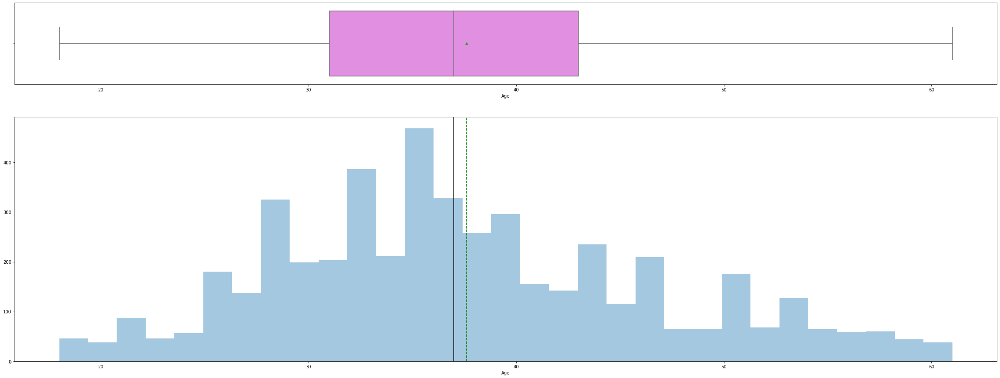

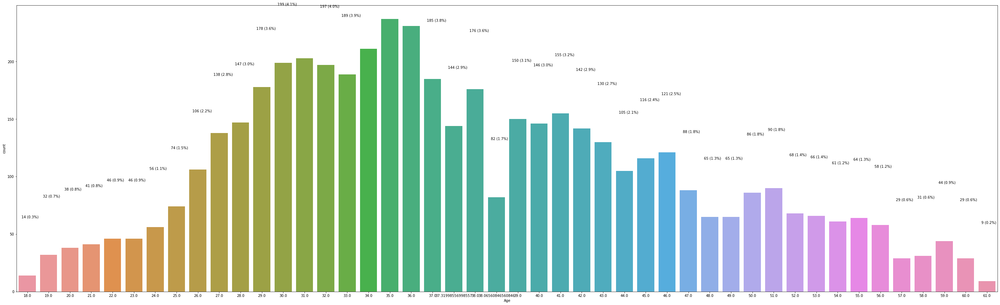

In [37]:
plotFeatures(["boxplot","histogram","countplot"], customerData["Age"])

    1) Age of the customers is slightly right skewed. Mean is slightly above the 50 Percentile. 
    2) There are no outliers in terms of customer age. 
    3) Yougest Customers are 18 year old while, oldest customers are 61 year old.
    4) As per the box plot, majority of customers are in age group of Low Thirties to Mid Forties

**Observations on `TypeofContact`**

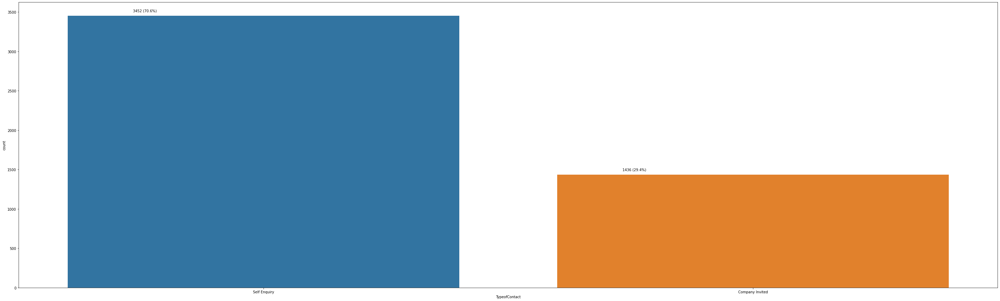

In [38]:
draw_countplot_with_count_percentage(customerData["TypeofContact"])

     1) Over 70% of customers did Self Enquiry.
     2) Only around 30% of customers were contacted based on Company's Invitations. 

**Observations on `CityTier`**

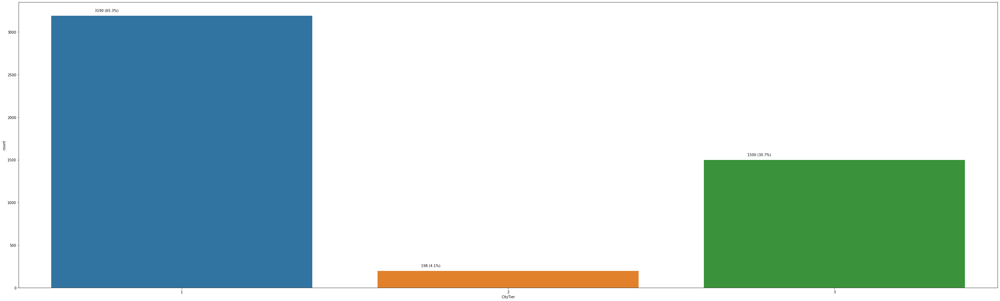

In [39]:
draw_countplot_with_count_percentage(customerData["CityTier"])

    1) As its clear from the plot above, around 65% of customers resides in Tier 1 cities. 
    2) 30% of customers resides in Tier 3 cities. 
    3) Only 4% of customers resides in Tier 2 cities. 
    
    **Note** - This is surprising that much larger customers pool resides in Tier 3 cities compare to Tier 2. 

**Observations on `ProdTaken`**

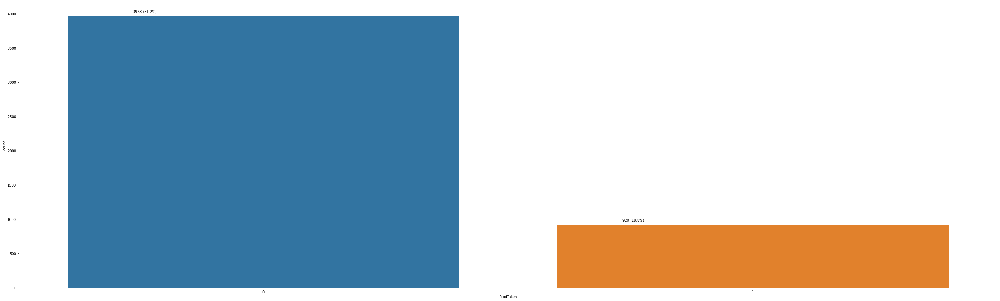

In [40]:
draw_countplot_with_count_percentage(customerData["ProdTaken"])

   For the Target Variable only around 19% of customers who were contacted and pitched for actually abouth a Travel product. This indicates the conversion rate is less than 1 in 5. 

**Observations on `DurationOfPitch`**

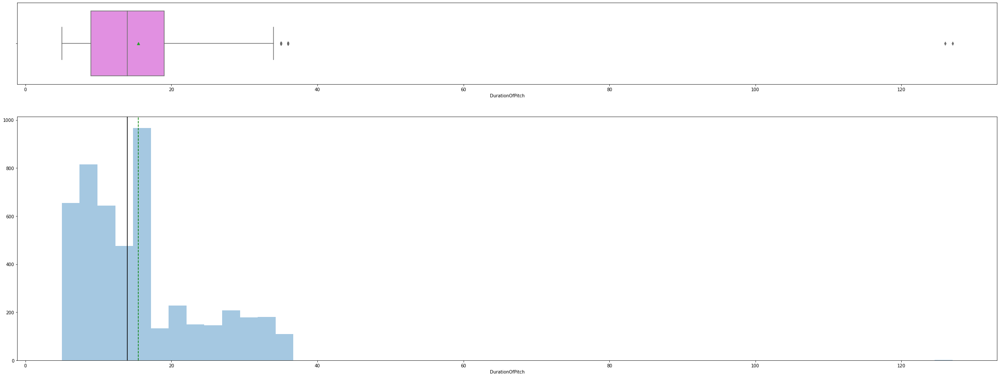

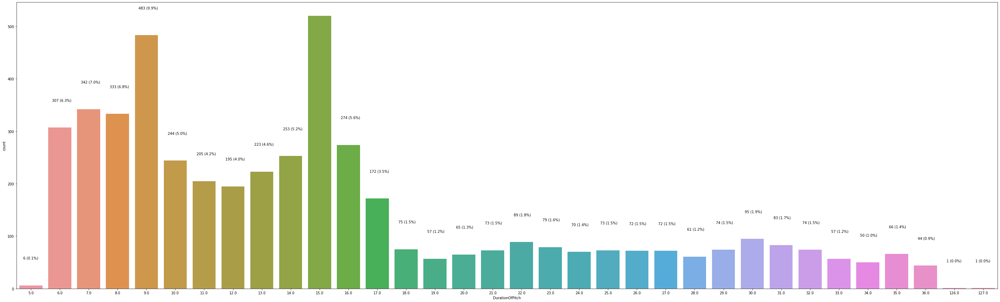

In [41]:
plotFeatures(["boxplot","histogram","countplot"], customerData["DurationOfPitch"])

    1) Clearly there are few outliers on the upper end for the duration of pitch data. 
    2) Lowest duration of pitch is 5 units and highest is at 127 units. 
    3) Since there are just 2 values above 36, (1 customer each with with 126 and 127), it looks more like an data error rather than true outlier. 

**Observations on `Occupation`**

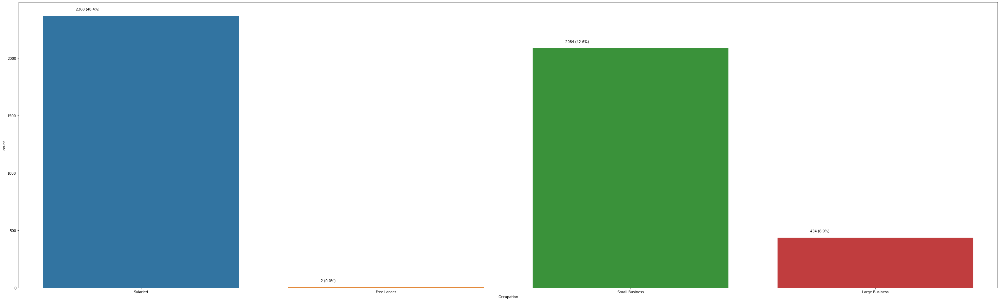

In [42]:
draw_countplot_with_count_percentage(customerData["Occupation"])

    1) Around 48% of customers are Salaried.
    2) Around 42% of customers are Small Business Owners. 
    3) Around 9% of customers are Large Business Owners. 
    4) There are only 2 customers that Free Lancer.
    
    Hypothesis - It's possibility that these 2 freelancer customers are the customers with extremely high Sales Pitch Duration. We will know more about it in BiVariate Analysis. 

**Observations on `Gender`**

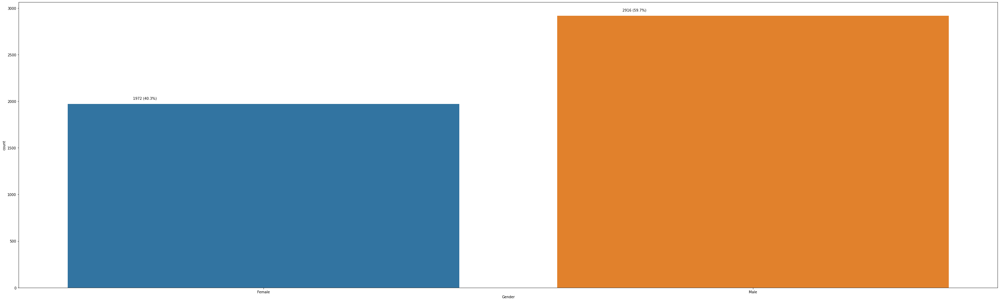

In [43]:
draw_countplot_with_count_percentage(customerData["Gender"])

  Around 60% of the customers are Male and 40% Female.

**Observations on `NumberOfPersonVisiting`**

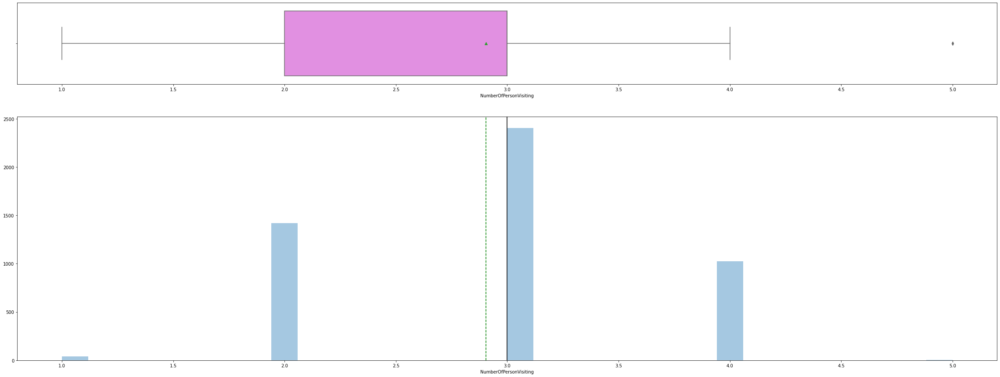

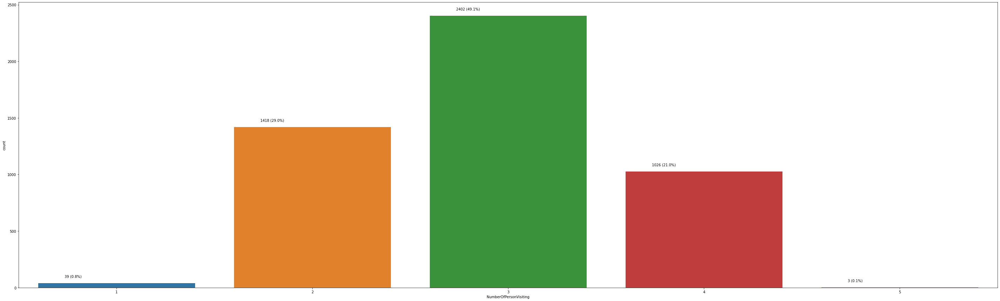

In [44]:
plotFeatures(["boxplot","histogram","countplot"], customerData["NumberOfPersonVisiting"])

    1) As per the charts above, around 50% of the customer mentioned had 3 people planning to Travelling. 
    2) Around 1/3 of Customers mentioned they plan to travel in group of 2. 
    3) Around 21% of Customers mentioned they would travel in group of 4. 
    4) Less than 1% of Customers mentioned they would travel alone. 
    5) There are only 3 customers that mentioned they would travel in a group of 5 people. 
    
    Note - Most customers plan to travel in a group of 2 to 3 people. 

**Observations on `NumberOfFollowups`**

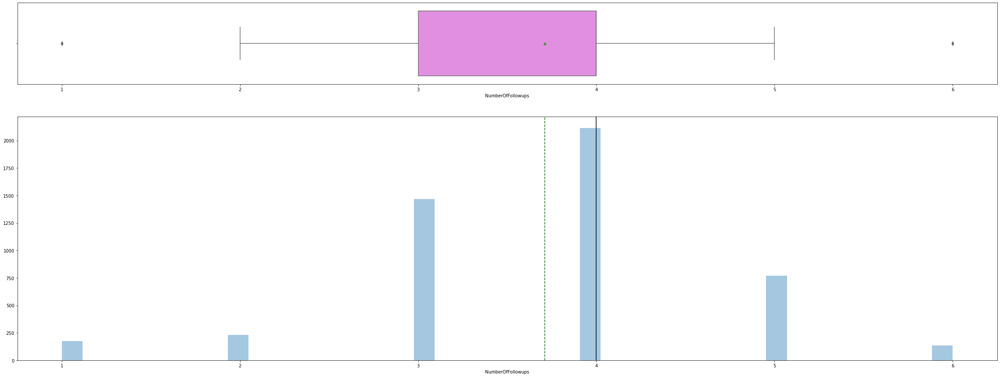

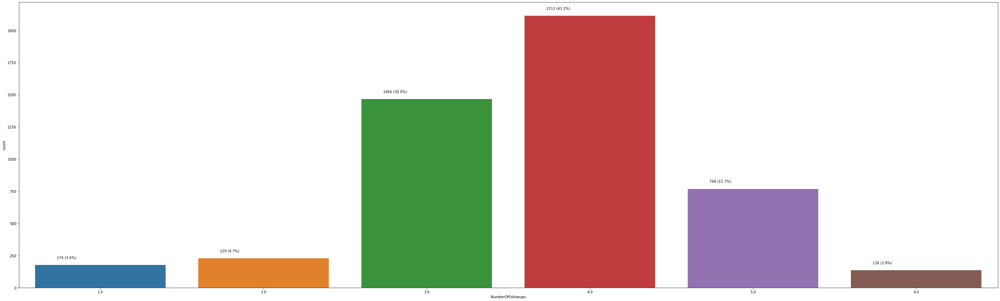

In [45]:
plotFeatures(["boxplot","histogram","countplot"], customerData["NumberOfFollowups"])

    1) Around 40% customers had 4 followups. 
    2) Around 30% of customers had 3 followups. 
    3) Most customers (around 90%) had between 3 to 5 followups. 
    4) Very few customers had 2 or less followups (4.7% had 2 followups and 3.6% had 1 followup)
    5) There are around 2.6% of customers that had 6 followups. 
    

**Observations on `ProductPitched`**

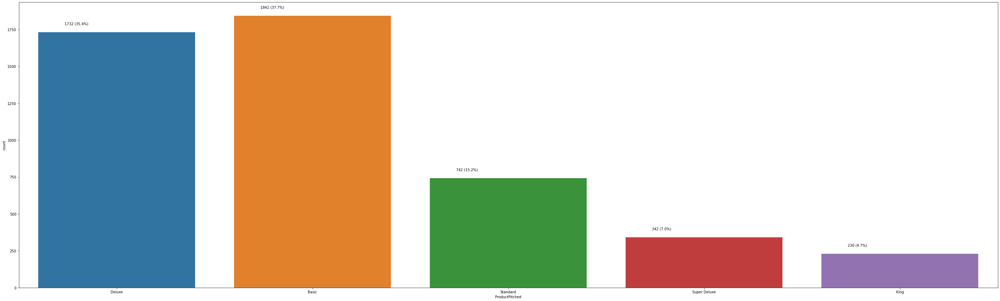

In [46]:
draw_countplot_with_count_percentage(customerData["ProductPitched"])

    1) Basic is the product most pitched by Sales Person to about 37.7% of the customers followed by Delux to 35.4% of customers. 
    2) Sales People pitched less about Standard (15.2%), Super Deluxe (7%) and King (4.7%)
    

**Observations on `PreferredPropertyStar`**

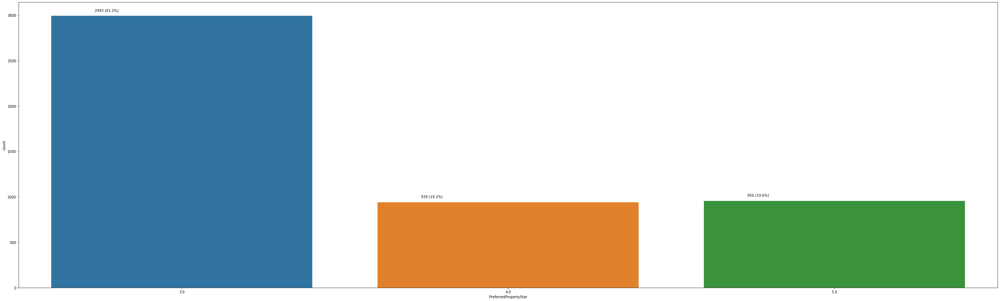

In [47]:
draw_countplot_with_count_percentage(customerData["PreferredPropertyStar"])

    1) Its clear that 3 Star hotels are most preferred by the customers. (around 61% of customers preferred 3 star hotel)
    2) Almost equal number of customers preferred Hotels with 4 & 5 Stars.
    
    Note - Its clear that customer only prefer to stay in Hotel with at least 3 star and above.

**Observations on `MaritalStatus`**

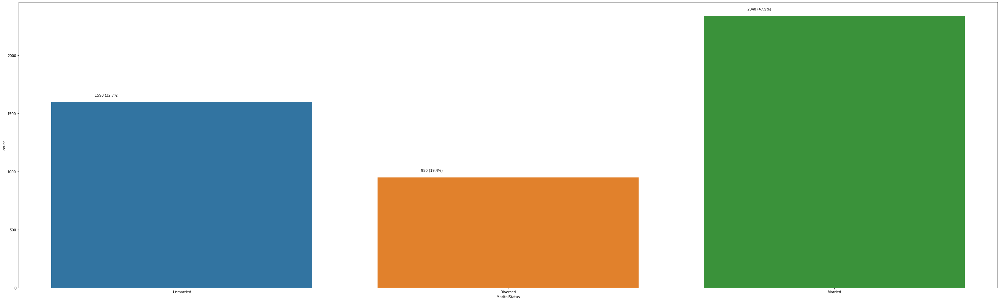

In [48]:
draw_countplot_with_count_percentage(customerData["MaritalStatus"])

    1) Around 47% of customers are Married. 
    2) Around 20% of customers are Divorced. 
    3) 37% of customers are Unmarried or Single. 
    
    Note - Even though 37% of customers are Unmarried or Single, less than 1% of customers mentioned they plan to travel alone. 

**Observations on `NumberOfTrips`**

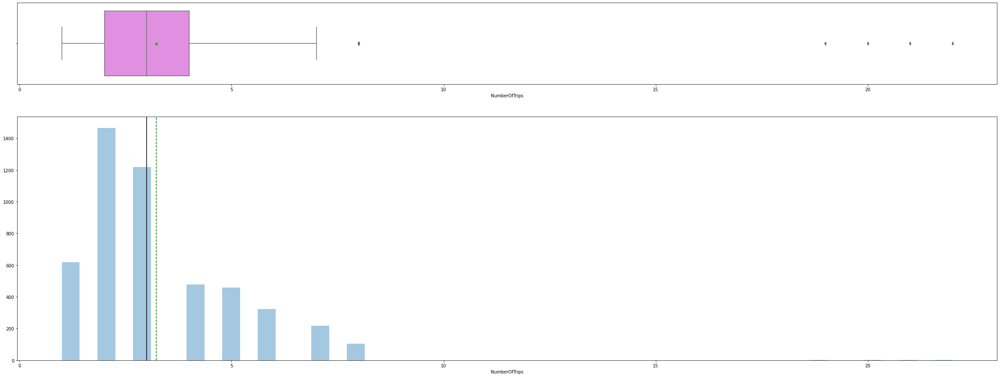

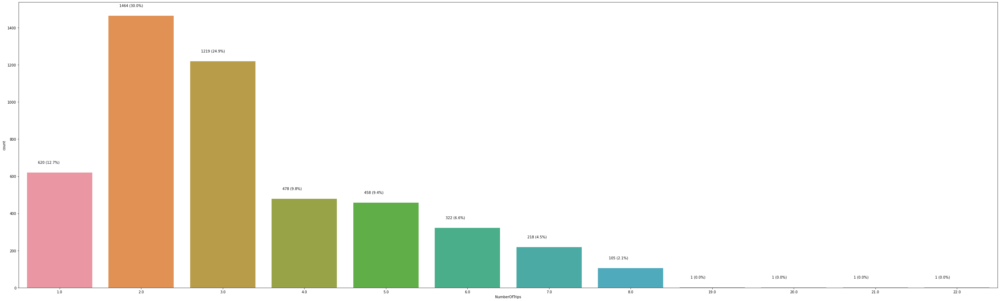

In [49]:
plotFeatures(["boxplot","histogram","countplot"], customerData["NumberOfTrips"])

    1) Data is right skewed with quite a few outliers on the higher end. 
    2) Most customers make between 2 to 3 trips in a year. 
    3) There are few customers with high travel frequencey between 4 to 8 trips a year. 
    4) There are only 4 customers which reported extremely high travel frequency (19 and above). They are definetly the outliers. 
    

**Observations on `Passport`**

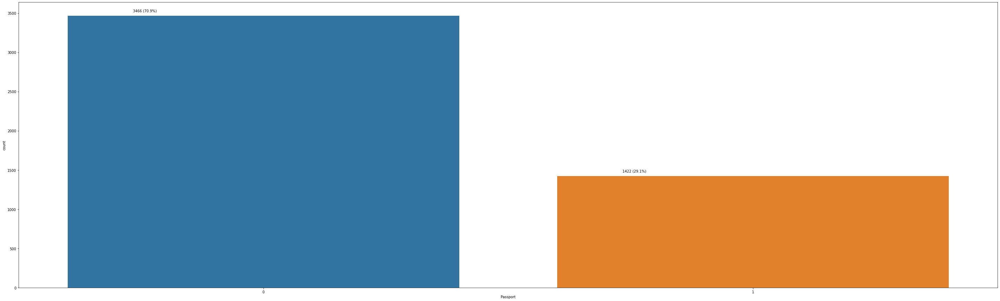

In [50]:
draw_countplot_with_count_percentage(customerData["Passport"])

    1) Most customers around 70% don't have Passport.
    2) Only 30% of customers have passport. 
    
    Note - This is very interesting and as it may give some business insights to the company. 
    

**Observations on `PitchSatisfactionScore`**

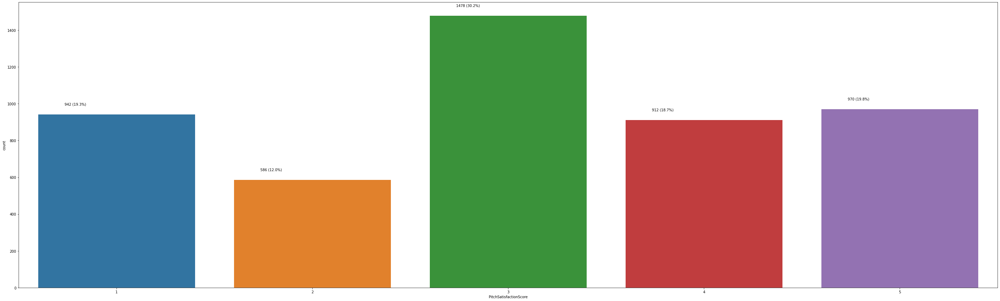

In [51]:
draw_countplot_with_count_percentage(customerData["PitchSatisfactionScore"])

    1) The chart above gives an idea about how good sales people are doing in their sales pitch. 
    2) Around 30% of customers have given a Pitch Satisfaction score of 3. (which is in middle).
    3) Around 40% of customers have rate Pitch Satisfaction score of 4 & above. 
    4) There's definetly some opportunity areas in improving Sales Pitch by sales people as around 32% customers have rated 2 or below as their satisfaction score.
    
    Note - I am making an assumption that Score of 5 is best and score of 1 is lowest. Since its not clarified anywhere in the problem statement. 
    

**Observations on `OwnCar`**

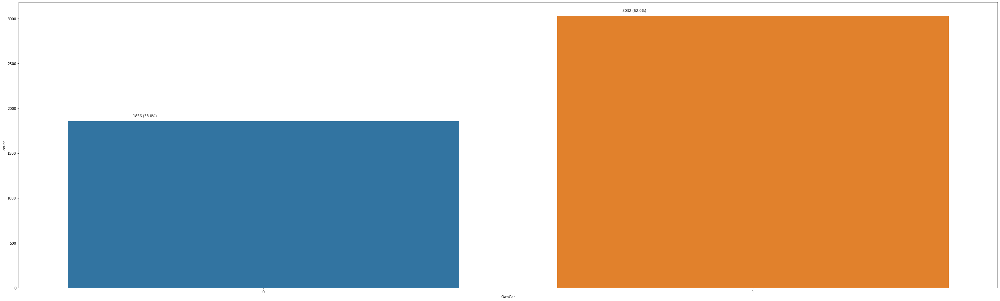

In [52]:
draw_countplot_with_count_percentage(customerData["OwnCar"])

    1) Around 62% of customers owns at least 1 car. 
    2) Around 38% of customers don't own any cars. 
    
    Note - We should look for any coorelation of car ownership with target variable. 

**Observations on `NumberOfChildrenVisiting`**

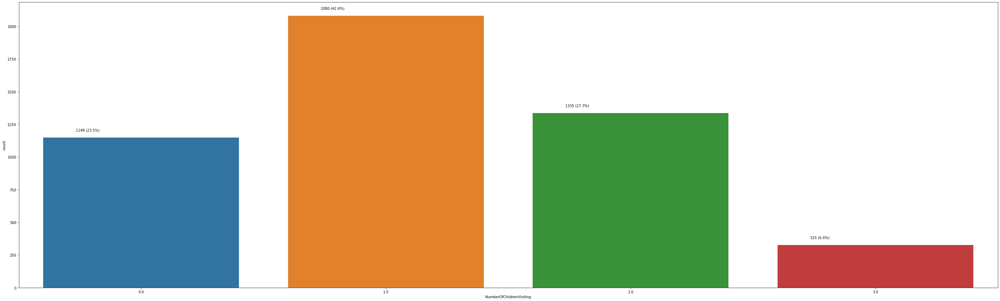

In [53]:
draw_countplot_with_count_percentage(customerData["NumberOfChildrenVisiting"])

    1) Over 75% of customers plan to travel with at least 1 children under age of 5 years. Mostly with 1 kid (42.6%) followed by 2 kids (27.3%) and 3 kids (6.6 %) 
    2) Around 23 % of customers don't plan to travel with any kids under 5 years. 

**Observations on `Designation`**

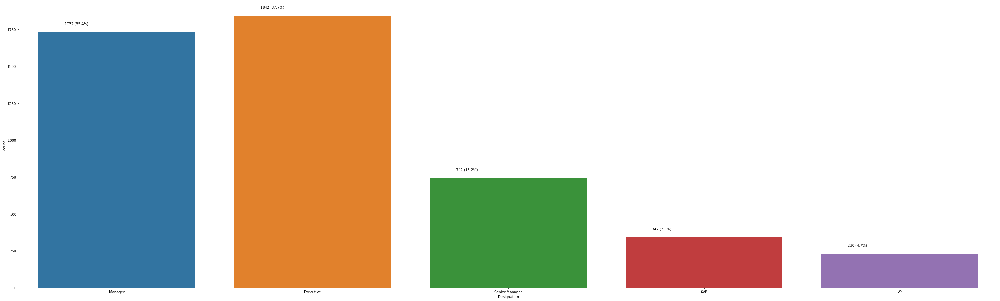

In [54]:
draw_countplot_with_count_percentage(customerData["Designation"])

    1) Most customers have a designation of Executive(37.7%) or Manager (35.4%). 
    2) There are some customer base with designation as Senior Manager(15.2%), AVP(7%) and VP(4.7%)

**Observations on `MonthlyIncome`**

In [55]:
customerData.MonthlyIncome.dtype

dtype('float64')

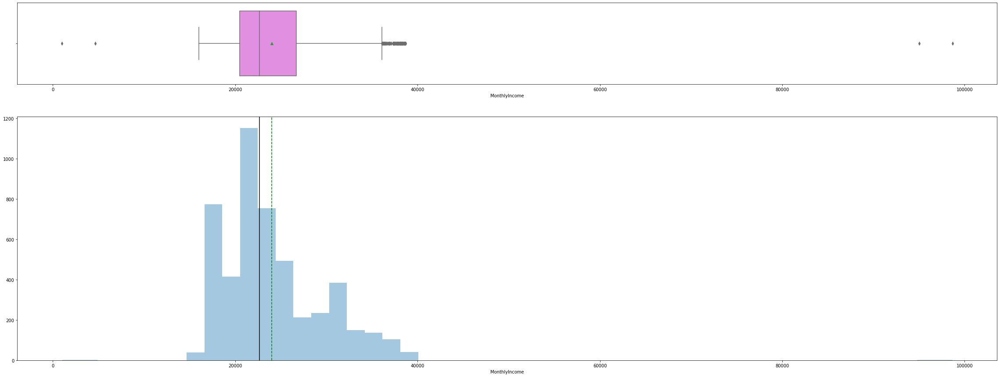

In [56]:
plotFeatures(["boxplot","histogram"], customerData["MonthlyIncome"])

    1) MonthlyIncome of the customers are rightly skewed. There are few outliers on the upper side, indicating that few customers earn significantly more than others. 
    2) High MonthlySalary could correlate to designation or occupation. We will do more during bivariate & multivariate analysis.
    

**`BiVariate` & `MultiVariate` Analysis**

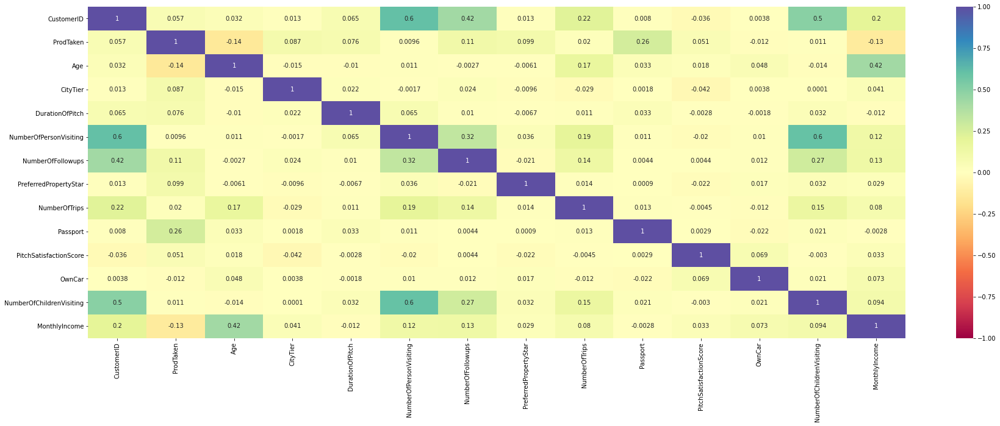

In [57]:
plt.figure(figsize=(30, 10))
sns.heatmap(customerData.corr(), annot=True, vmin=-1, vmax=1, cmap="Spectral")
plt.show()

    1) ProdTaken has some positive correlation with customer who has passport. 
    2) Age & Monthly Income has positive correlation. 
    3) CityTier, DurationOfPitch, PreferredPropertyStar, PitchSatisfactionScore, OwnCar have very low or almost negligible correlation with Target variable and other dependent variables. 
    4) NumberOfPersonVisiting & NumberOfChildrenVisiting have a strong relationship of 0.6. And this makes sense as children plan to travel adds upto total persons that plan to travel. We should see if one of them can be dropped. 
    5) There is some positive correlation between NumberOfPersonVisiting and NumberOfFollowups done by SalesPerson.
    6) NumberOfTrips has a positive relationship with Age, NumberOfPersonVisiting, NumberOfFollowups and NumberOfChildrenVisiting.
    7) NumberOfChildrenVisitng and NumberOfPersonVisiting both have some positive correlation with NumberOfFollowups and NumberOfTrips. This makes our case of dropping one in lieu of other stronger. 
    8) MonthlyIncome has a negative correlation with ProdTaken. This is a strong metrics, as higher income group customers which can afford to travel, aren't taking product from the company.
    9) MonthlyIncome has a positive correlation with NumberOfPersonVisting and NumberOfFollowups.
    10) Age has a positive correlation with NumberOfTrips. So older customers tend to travel more than younger customers.

**Visualizing the same information using a pairplot**

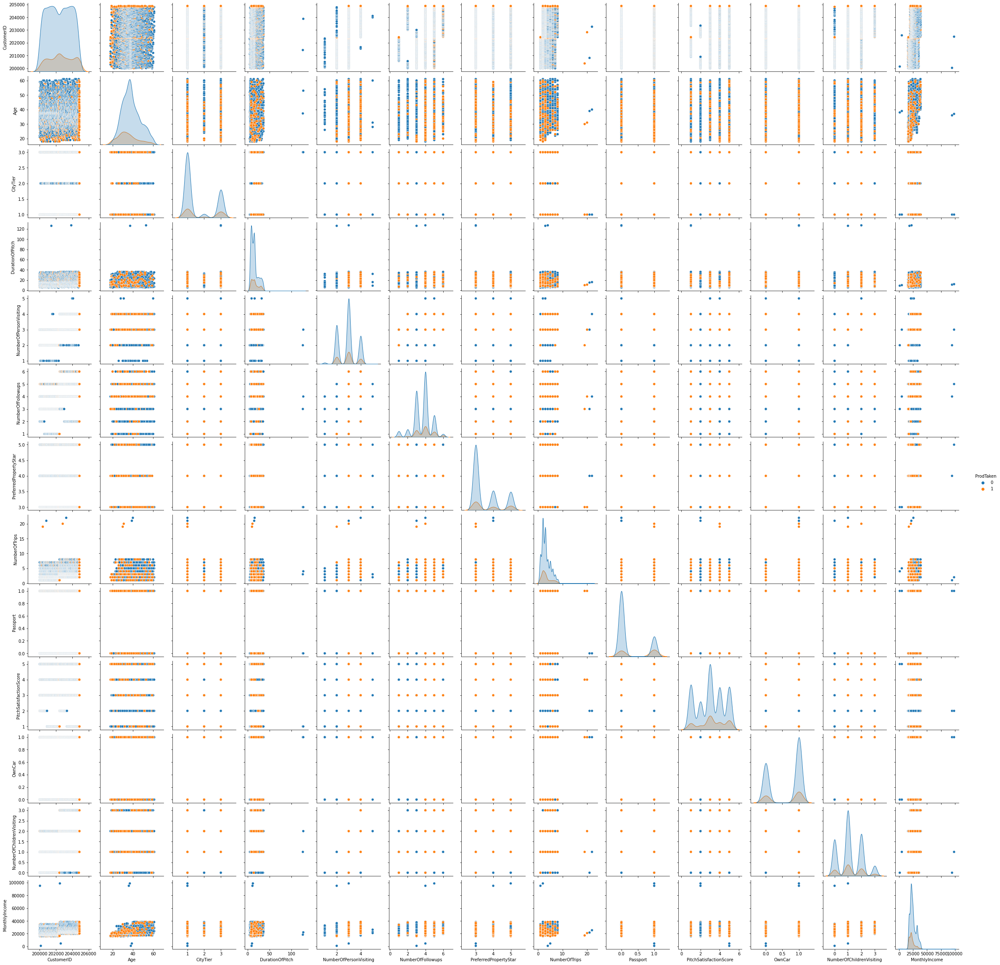

In [58]:
sns.pairplot(data=customerData, hue="ProdTaken")
plt.show()

We notice the same correlation information in pairplot as we see in the heat map above.

### `ProdTaken vs Age` 

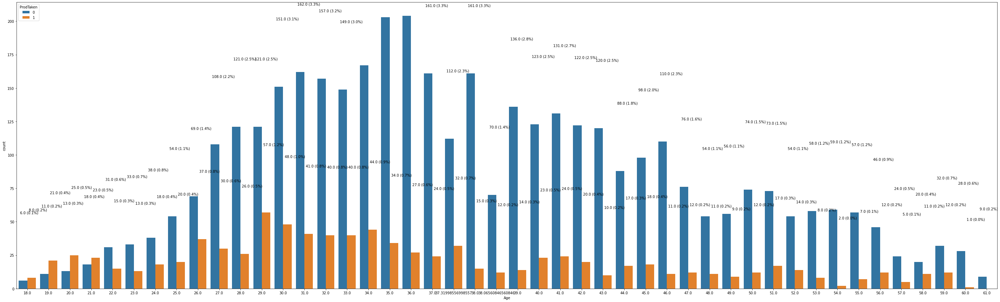

In [60]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData,column="Age", hueColumn="ProdTaken")

    1) Customers who bought the product vs not in their age group, all belong to under 21 years of age. 
    2) This indicates Customers below 21 years of age have higher probablity of buying a product. 

### `ProdTaken vs CityTier` 

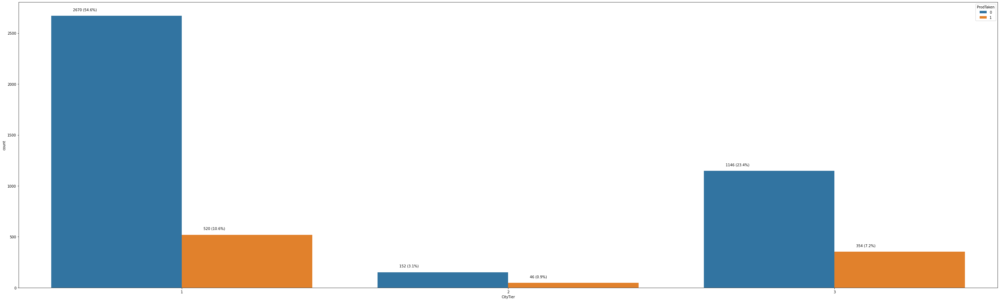

In [62]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="CityTier", hueColumn="ProdTaken")

    1) Most customers belong to Tier 1 Cities followed by Tier 3 & Tier 2. 
    
    2) Out of 3190 Tier 1 city customers, 16.3% bought a product. 
    
    3) Out of 198 Tier 2 city customers, 23.23% bought a product. 
    
    4) Out of 1500 Tier 3 city customers, 23.6% bought a product.
    
**Key Takeaway** - So even though few customers are from Tier 2 cities, their percentage of buying a product is higher than Tier 1. Company should focus more on customers in Tier 2 cities for a better chance to get their business.

**`ProdTaken vs TypeofContact`**

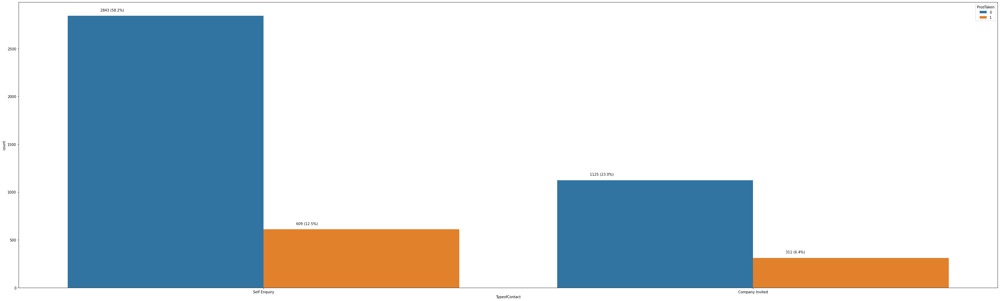

In [64]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="TypeofContact", hueColumn="ProdTaken")

    Its clear that customers invited by Company has higher percentage of buying a travel product, than customers who self enquired.
    
    In other words out of 3452 customers who self enquired 17.4% actually bought a travel plan, while out of 1436 customer who company reached out to, 21.6% customers bought a travel plan. 
    
**Key Takeaway** - Company's invitation does make a positive difference in customer buying a product. 

**`ProdTaken vs DurationOfPitch`**

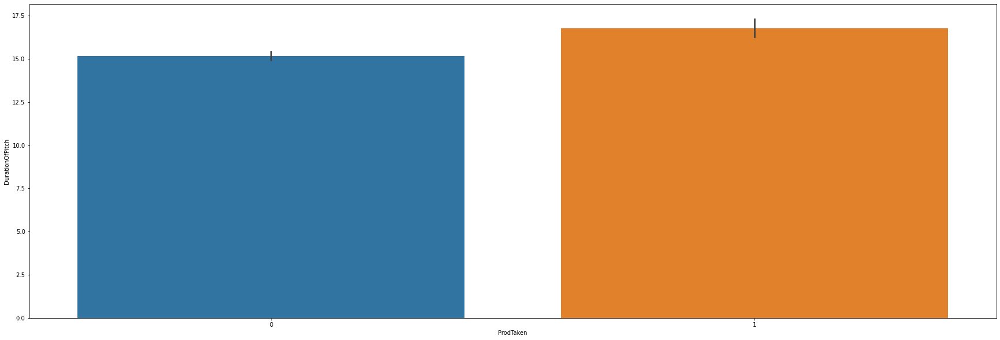

In [65]:
plt.figure(figsize=(30,10))
sns.barplot(y="DurationOfPitch", x="ProdTaken", data=customerData)
plt.show()

  Based on the chart above, it seems like customers who purchased a product, had a longer DurationOfPitch.

**`ProdTaken vs Occupation`**

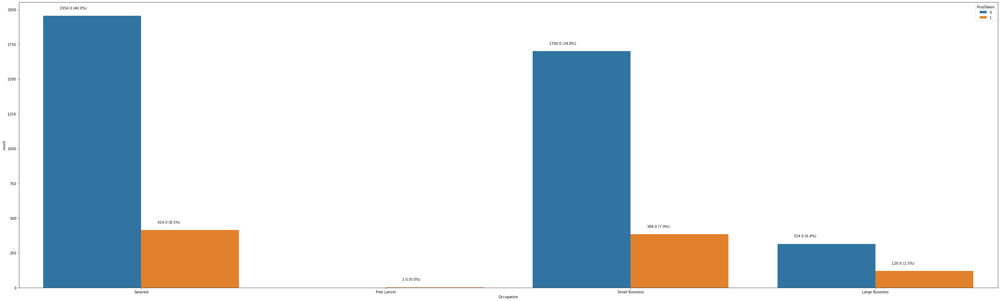

In [67]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="Occupation", hueColumn="ProdTaken")

    1) There is less data available for customers with Occupation as Free Lancer, but both customers have bought products. 
    
    2) Around 17.4% of Salaried customers, 18.4% of Customers with Small Business and 27.6% of customers with large business have bought Product in the past. 
    
    Key Takeaway - Large Business customers & Freelancer tend to buy product more, however their representation is not big enough, and hence this correlation is not reflected in overall dataset analysis.

**`ProdTaken vs Gender`**

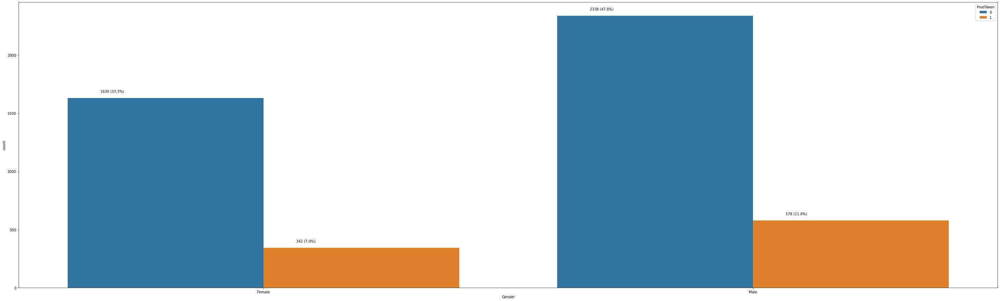

In [69]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="Gender", hueColumn="ProdTaken")

    1) 17.3% of Female customers have bought Product in the past. 
    
    2) 19.8% of Male customers have bought Product in the past. 
    
    Male customers tend to by product slightly higher than Female. 

**`ProdTaken vs NumberOfPersonVisiting`**

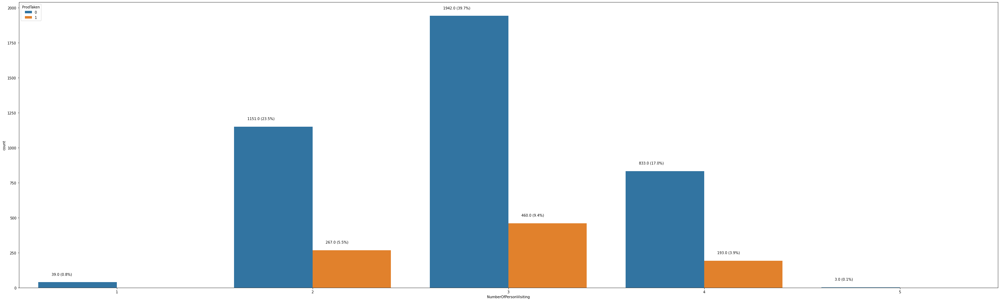

In [70]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="NumberOfPersonVisiting", hueColumn="ProdTaken")

    1) Customers who plan to travel alone or with a group of 5 represent very low percentage of overall customers, but none of them bought any product from the company. 
    
    2) Out of all customers who plan to travel in group of 2, 18.8% of customers actually bought a product.
    
    3) Out of all customers who plan to travel in group of 3, 19.1% of customers actually bought a product.
    
    4) Out of all customers who plan to travel in group of 4, 18.8% of customers actuallu bought a product. 
    
    Key Takeaways - Company's product are equally popular and bought by Customers who plan to travel in group of 2,3,4.

**`ProdTaken vs NumberOfChildrenVisiting`**

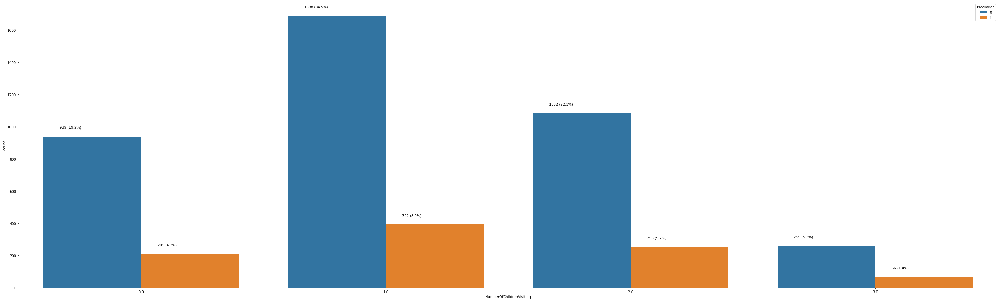

In [71]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="NumberOfChildrenVisiting", hueColumn="ProdTaken")

    1) Out of all the Customers who plan to travel with 0 children under age of 5, 18.2 % have bought a product.
    
    2) Out of all Customers who plan to travel with 1 children under the age of 5, 18.8% have bough a product. 
    
    3) Out of all Customers who plan to travel with 2 children under the age of 5, 18.9% have bough a product. 
    
    4) Out of all Customers who plan to travel with 3 children under the age of 5, 20.3% have bough a product. 
    
    Key Takeaways - There is a clear uniformity of customers who plan to travel with and without kids. NumberOfChildrenVisiting also has a high colleration with NumberOfPeople visitng. Hence its safe to drop this feature for model building. 

**`ProdTaken vs PreferredPropertyStar`**

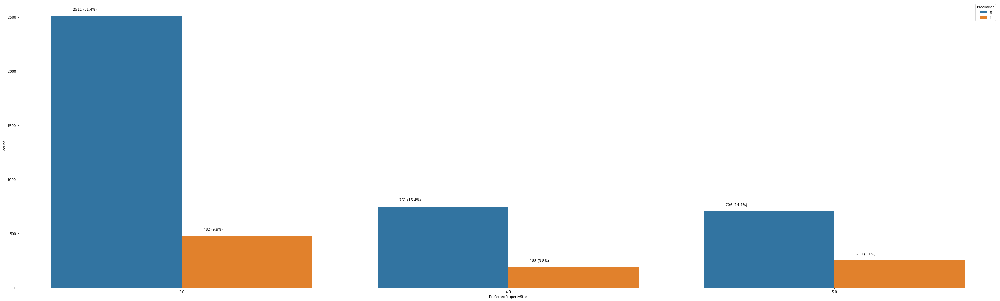

In [72]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="PreferredPropertyStar", hueColumn="ProdTaken")

    1) Out of all customers who preferred to stay in 3 star hotel, 16.1% of customers actually bought a product. 
    
    2) Out of all customers who preferred to stay in 4 star hotel, 20.0% of customers actually bought a product. 
    
    3) Out of all customers who preferred to stay in 5 star hotel, 26.0% of customers actually bought a product. 
    
    Key Takeaways - Clearly customers who preferred to stay in better starred hotels tends to buy a product. This is very important insights for buisness. 

**`ProdTaken vs MaritalStatus`**

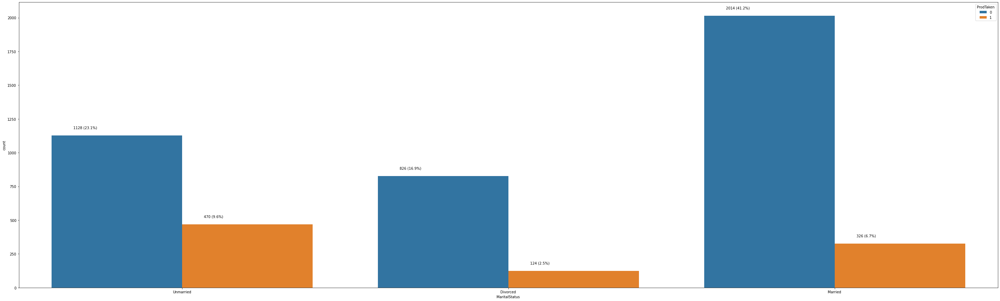

In [73]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="MaritalStatus", hueColumn="ProdTaken")

    1) Out of all Unmarried customers 29% of customers have bought a product in the past. 
    
    2) Out of all Divorced customers 13% of customers have bought a product in the past. 
    
    3) Out of all Married customers 14% of customers have bought a product in the past. 
    
    Key Takeaways - A good % of unmarried customers buy the product, while Divorced & Married customers buy % is low. 

**`ProdTaken vs NumberOfTrips`**

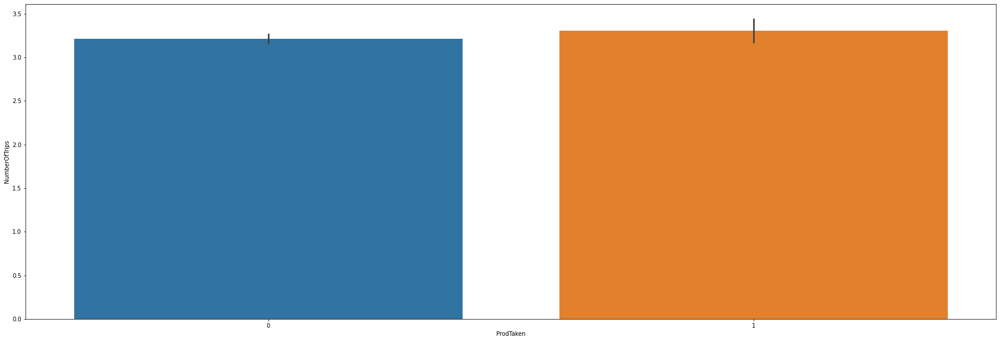

In [74]:
plt.figure(figsize=(30,10))
sns.barplot(y="NumberOfTrips", x="ProdTaken", data=customerData)
plt.show()

    As its clear from the barplot above, customers who have taken the product previously, tends to travel a bit more than those who haven't. Although the difference is not huge.

**`ProdTaken vs Passport`**

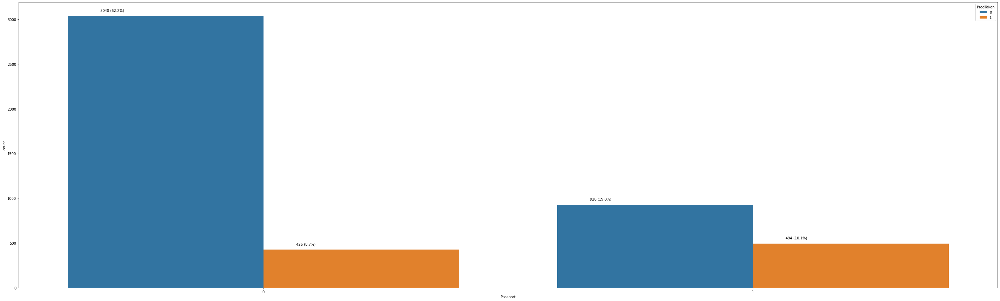

In [76]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="Passport", hueColumn="ProdTaken")

**Key Takeaway** - 34.7% of Customer's with passport bought a Travel Product from the company, compare to only 12.28% of customers who don't have passport. This is a very key insights for business. 

**`ProdTaken vs OwnCar`**

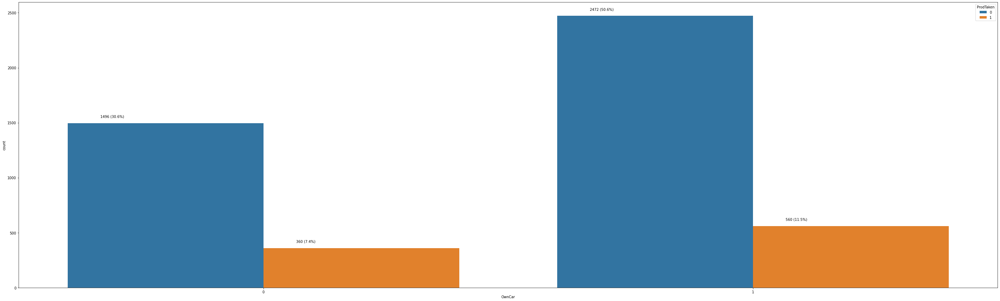

In [77]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="OwnCar", hueColumn="ProdTaken")

     1) 19% of customer who don't own car bought a Travel Product in the past, while 18.4% of customer who owns the car bought a Travel Product. 
     
     Key Takeway - Car ownership doesn't make any difference in Customer buying a Travel product. 

**`ProdTaken vs Designation`**

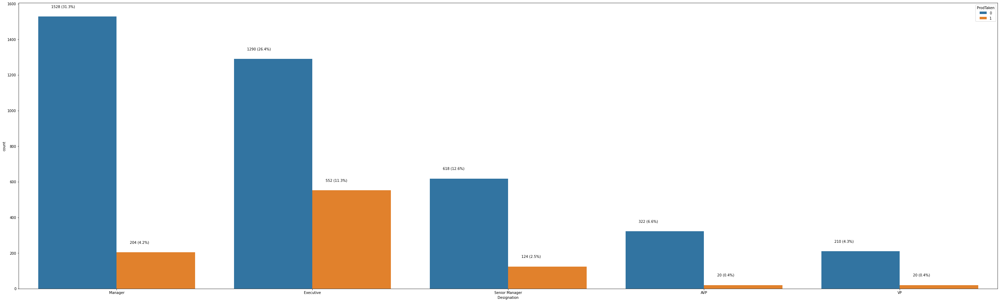

In [78]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="Designation", hueColumn="ProdTaken")

   1) 11.1% of customers with `Desgination` of `Manager` bought Travel Product in the past. 
   
   2) 29.9% of customers with `Designation` of `Executive` bought Travel Product in the past. 
   
   3) 16.8% of customers with `Designation` of `Senior Manager`, 5% of customers with `Designation` of `AVP` and 8.6% of customers with `Designation` of `VP` have purchased products in the past. 
   
   Key TakeAway - Customers with senrior Designation and Executive level didn't buy Product with the company. This is another key insight for Business and area of focus/opportunity for them. 

**`ProdTaken vs MonthlyIncome`**

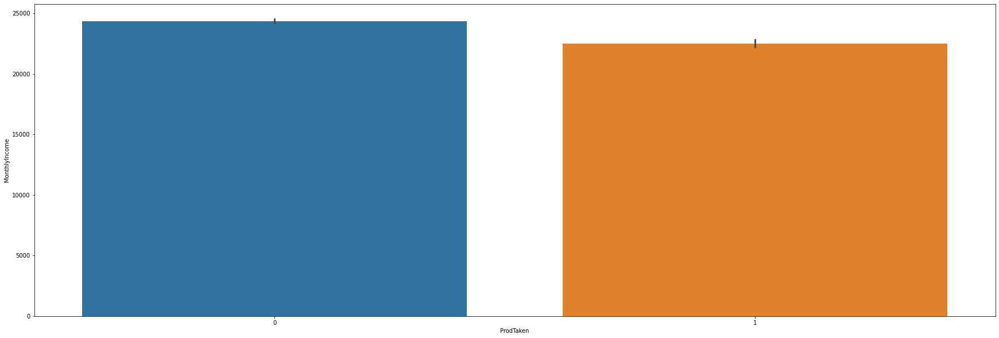

In [79]:
plt.figure(figsize=(30,10))
sns.barplot(y="MonthlyIncome", x="ProdTaken", data=customerData)
plt.show()

    As its clear from the barplot above, customers who bought and didn't buy the product in the past have similar Monthly Income distribution. 

## Analysis of Customer base in general. 

### `Designation vs ProductPitched`

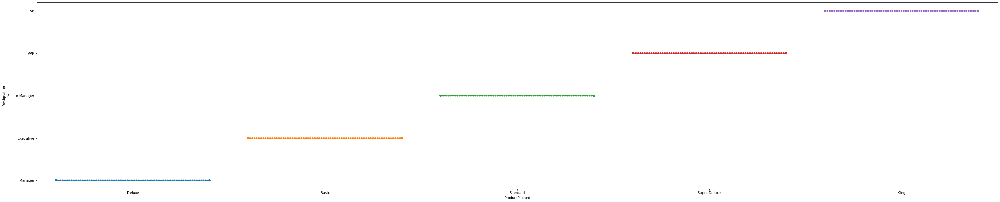

In [80]:
plt.figure(figsize=(50,10))
sns.swarmplot(x="ProductPitched", y="Designation", data=customerData)
plt.show()

 The swarm plot shows a very important fact, Only One type of package was pitched to a specific Designation. 
 
     1) Deluxe Package was Pitched only to Manager (1732 customers)
     2) Basic Package was Pitched only to Executive (1842 customers)
     3) Standard Package was Pitched only to Senior Manager (742 customers)
     4) Super Deluxe Package was Pitched only to AVP (342)
     5) King Package was Pitched only to VP (230)
     
  We can drop either Designation or ProductPitched from model building, as it has a perfect correlation. I will drop Designation, and keep ProductPitched.   

### `MonthlyIncome vs Designation`

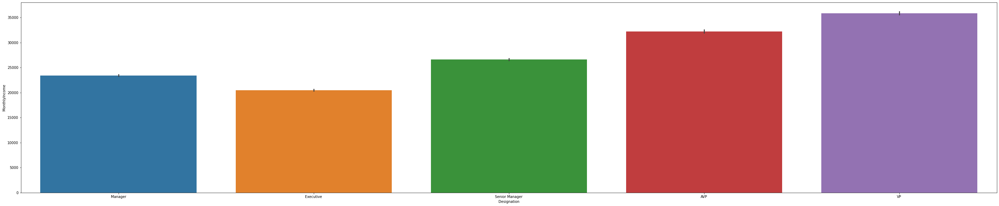

In [81]:
plt.figure(figsize=(50,10))
sns.barplot(x="Designation", y="MonthlyIncome", data=customerData)
plt.show()

    Income of customers are in according to their Designation, in the increasing order of Executive, Manager, Senior Manager, AVP and VP. 

### `Designation vs Gender`

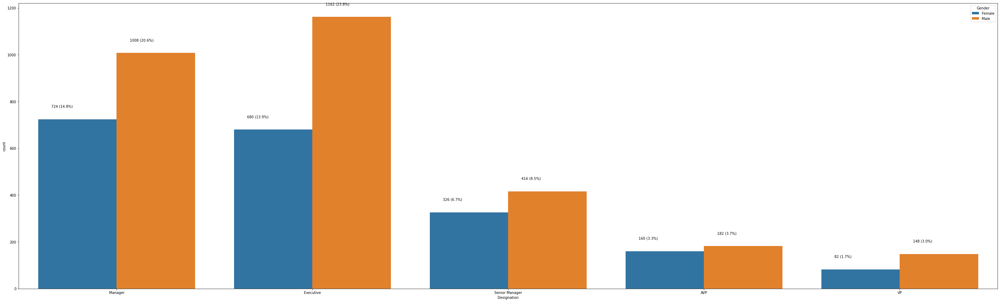

In [83]:
draw_countplot_with_count_percentage_withhue(dataframe=customerData, column="Designation", hueColumn="Gender")

 1) Male customers are more than female customers in every Designation. 
 
 2) The Gender ratio improves from Executive (lowest level) to VP (higest level).

### `ProductPitched vs NumberOfFollowups`

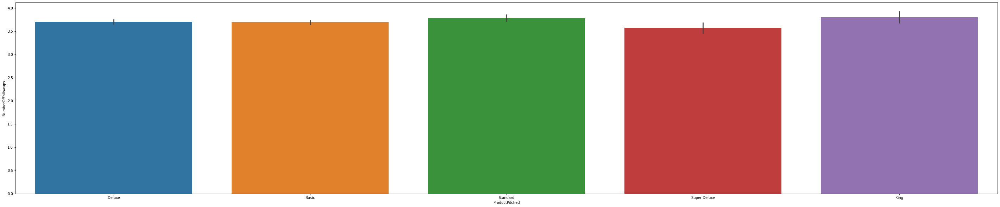

In [171]:
plt.figure(figsize=(50,10))
sns.barplot(x="ProductPitched", y="NumberOfFollowups", data=customerData)
plt.show()

  Mean NumberOfFollowups are almost equal across all Product Categories. 

### `ProductPitched vs NumberOfPersonVisiting`

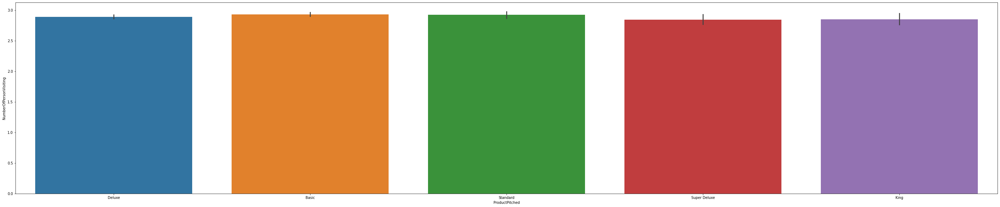

In [172]:
plt.figure(figsize=(50,10))
sns.barplot(x="ProductPitched", y="NumberOfPersonVisiting", data=customerData)
plt.show()

  Mean Number Of Person planned to visit is almost equal across all Product categories. 

### `ProductPitched vs MaritalStatus`

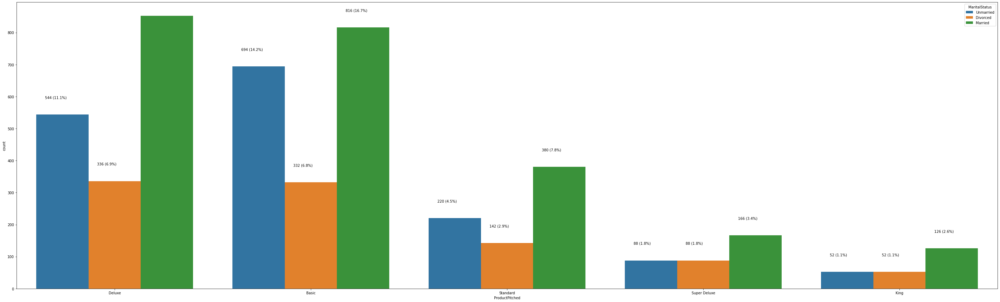

In [175]:
draw_countplot_with_count_percentage(dataframe=customerData, column="ProductPitched", hueColumn="MaritalStatus")

 1) Married customers were pitched most across all Product Families. 
 
 2) Super Delux & King products were Pitched equally among Divorced & Unmarried Customers. 
 
 3) Delux, Basic & Standard Products were pitched more for Unmarried Customers compare to Divorced Customers. 
 

### `ProductPitched vs Passport`

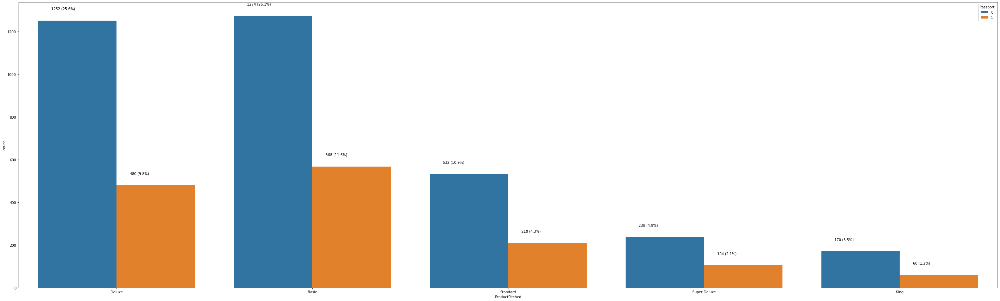

In [176]:
draw_countplot_with_count_percentage(dataframe=customerData, column="ProductPitched", hueColumn="Passport")

 All products were pitched more to customers without Passport vs customer with Passport.

### `ProductPitched vs CityTier`

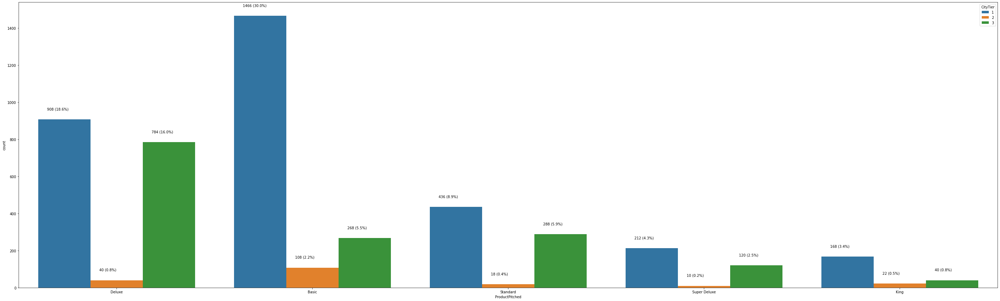

In [177]:
draw_countplot_with_count_percentage(dataframe=customerData, column="ProductPitched", hueColumn="CityTier")

   1) Basic package was predominantly pitched in Tier 1 cities, followed by Tier 3 & Tier 2 cities. Basic Package was also pitched the most among all packages. 
   
   2) Delux package was pitched most in Tier 1 cities, followed by Tier 3. But difference is not that high as Basic package. 
   
   3) All other packages were pitched higher in Tier 1 cities, followed by Tier 3 & Tier 2 cities. This could be because the in general customer reside.

### `ProductPitched vs DurationOfPitch`

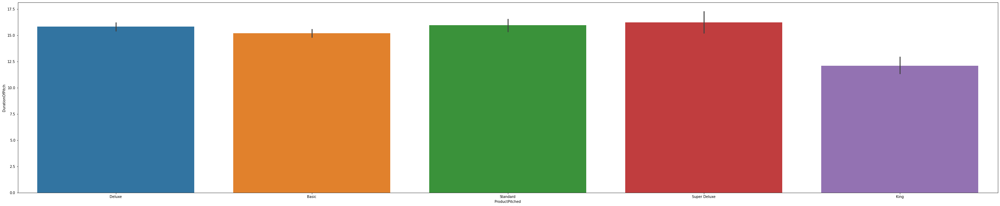

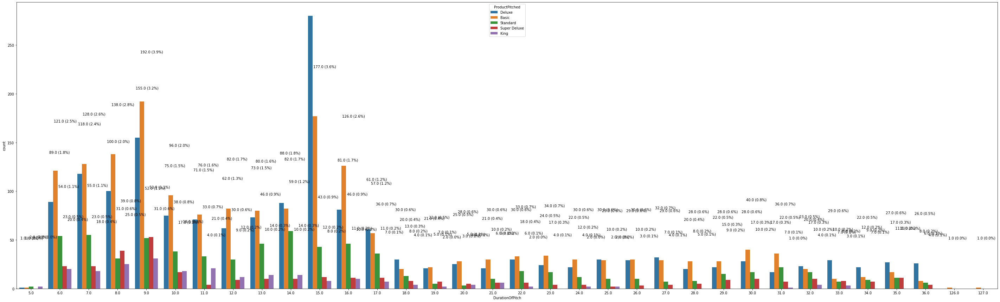

In [180]:
plt.figure(figsize=(50,10))
sns.barplot(x="ProductPitched", y="DurationOfPitch", data=customerData)
plt.show()
draw_countplot_with_count_percentage(dataframe=customerData, column="DurationOfPitch", hueColumn="ProductPitched")

    1) On an avergae all Products are pitched for almost same duration except King.
    
    2) King Package that was pitched only to VP, was pitched for lower duration. 

### `ProductPitched vs PitchSatisfactionScore`

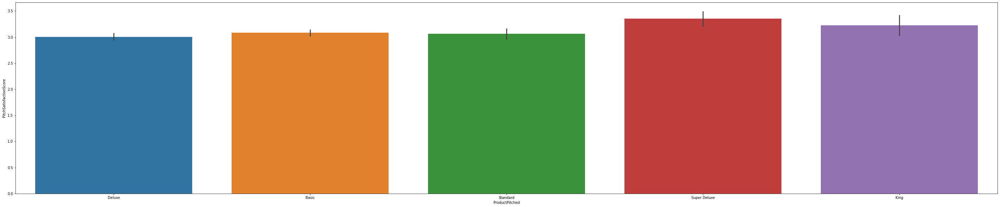

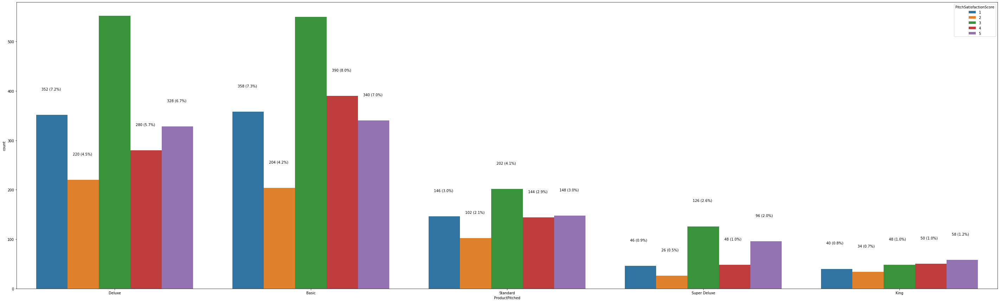

In [182]:
plt.figure(figsize=(50,10))
sns.barplot(x="ProductPitched", y="PitchSatisfactionScore", data=customerData)
plt.show()
draw_countplot_with_count_percentage(dataframe=customerData, column="ProductPitched", hueColumn="PitchSatisfactionScore")

   1) For Packages except King, most common Pitch Satisfaction Score is 3.
   
   2) Pitch for King Package has scored most Satisfaction score with highest being 5 followed by 4 and 3. This indicates customers (with designation of VP) were highly satisfied with Pitch for King Package. 
 

## Summary of EDA

**Data Description:**

- There were no duplicates records in the dataset. 
- There were some missing values in the dataset, and they were taken care of. 
- Dataset containes continuous variables with type of Int & Float and few categorical variables. 

   
**Summary of Customer Profile based on EDA**

    1) Most of the customers are in Age group of Low Thirties to Mid Forties, with youngest customer of 18 years and oldest of 61 years. 

    2) About 2/3 of customers (70%) did self enquiries and only 1/3 customers (30%) were contacted by the company. 

    3) Most customers (65%) reside in Tier 1 cities, followed by Tier 3 (30%). Tier 2 cities has very few customers (4.1%)

    4) Only 18% customers who were pitched for a product, actually bought it. Remaining 80% customers didn't buy any products.

    5) There are almost equal number of Salaried & Business Owning (Large & Small) customers. 

    6) 60% of the customers are Male and 40% are Female. 

    7) Most customers(over 3/4th) plan to travel in a group of 2 or 3 people. 

    8) Most customers (around 90%) had between 3 to 5 followups by salespeople after pitching for the package. 

    9) Customers only preferred to stay in Hotels with 3 stars & above. Although majority customers (60%) preferred 3 Star Hotel, equal number of customers preferred 4 & 5 Star hotel.

    10) Most customers were Married (48% ), followed by Unmarried (37%) and Divorced (20%).

    11) Most customers have a travel frequency of 2 to 3 trips a year. However there are very few customers with extremely high travel frequency. 

    12) Almost 70% of customers dont have passport.

    13) Most customers (68%) owns at least 1 car. 

    14) Most customers have to Executive and Manager designation. 

    15) Although number of customers belonging to Tier 2 cities are very low, but percentage of customers buying product from Tier 2 cities is higher than Tier 1 & Tier 3.

    16) Higher percentage of Customers with Large Business bought Travel product compare to customers with Smaller Business or are Salaried.

    17) Higher percentage of Male customers bought products than Female customers.

    18) Customers who preferred to stay in higher starred hotels tends to buy a product. Customers who preferred 5 Star 26% bought, with 4 star 20% bought and 3 star 16% actually bought.

    19) Higher percentage of unmarried customers buy the product, while Divorced & Married customers buy percentage is lower.

    20) 34.7% of Customers with Passport actually bought product, while only 12.8% of customers who don't have passport actually bought any product. Customers with passport have a better chance of buying a product. 

    21) Car ownership makes no difference in customers buying product. 

    22) Income of customers are in according to their Designation, in the increasing order of Executive, Manager, Senior Manager, AVP and VP. 

    23) The Gender ratio improves from Executive (lowest level) to VP (higest level).



**Summary of Product Packages and Pitch based on EDA**

    1) Basic & Deluxe packages were most pitched to the customers by salespeople. 

    2) Customers are largely satisfied with Sale Pitch, with around 40% customers giving Score of 4 and 30% customers giving score of 3.

    3) Companies invitation to customes to pitch the Product makes positive differenc in customers buying the product. 
        Out of 3452 customers who self enquired 17.4% actually bought a travel plan, while out of 1436 customer who company reached out to, 21.6% customers bought a travel plan. 

    4) Longer duration pitch increases the chances of customer buying a product. 

    5) Company's product are equally popular and bought by Customers who plan to travel in group of 2,3,4.

    6) Only 1 type of Product Package was pitched to specific Designation. 

    7) Married customers were pitched mostly across all product packages. Although Super Delux & King product were pitched equally among Divorced & Unnmarried customers.
        Delux, Basic & Standard products were pitched more for Unmarried customers compare to Divorced customers. 

    8) King Package was pitched to customer with Designation of VP and picthed for lowest duration. All other product packages were pitched for almost same duration. 

**Actions for data preparation:**

    - Treat outliers in MonthlyIncome column.
    - Fix 2 extremly high values of DurationOfPitch.
    - Create dummy variables for categorical columns. 
    - NumberOfChildrenVisting column can be dropped since it has a very correlation with NumberOfPeopleVisiting. 
    - Designation Column can be dropped as well, as only 1 type of package was pitched to each deisgnation level. 
    - Records of customers with occupation as freelance can be dropped, as there are only 2 such customers. No meaningful inference or predictions can be made on it. 
    - Drop CustomerID column.


## 5) Data Preparation  

In this step I will treat the outlier, drop columns and rows not required for model building

**Drop `CustomerID`, `NumberofChildrenVisiting` and `Designation` columns from the dataset**

In [84]:
customerData.drop(["CustomerID", "NumberOfChildrenVisiting", "Designation"], axis=1, inplace=True)
customerData.columns

Index(['ProdTaken', 'Age', 'TypeofContact', 'CityTier', 'DurationOfPitch',
       'Occupation', 'Gender', 'NumberOfPersonVisiting', 'NumberOfFollowups',
       'ProductPitched', 'PreferredPropertyStar', 'MaritalStatus',
       'NumberOfTrips', 'Passport', 'PitchSatisfactionScore', 'OwnCar',
       'MonthlyIncome'],
      dtype='object')

**Drop records for customer with `Free Lancer` as occupation**

In [85]:
customerData[customerData["Occupation"] == 'Free Lancer'].head()

customerData.drop(customerData.loc[customerData['Occupation']== 'Free Lancer'].index, inplace=True)

customerData[customerData["Occupation"] == 'Free Lancer'].head()

,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,MonthlyIncome


**Treat `MonthlyIncome` for outliers**

In [86]:
## Creating function to treat Outliers using IQR technique
def treat_outliers_using_IQR(data,col):
    Q1=data[col].quantile(0.25) # 25th quantile
    Q3=data[col].quantile(0.75)  # 75th quantile
    IQR=Q3-Q1
    Lower_Whisker = Q1 - 1.5*IQR 
    Upper_Whisker = Q3 + 1.5*IQR
    data[col] = np.clip(data[col], Lower_Whisker, Upper_Whisker) # all the values smaller than Lower_Whisker will be assigned value of Lower_whisker 
                                                            # and all the values above upper_whisker will be assigned value of upper_Whisker 
    return data

def treat_outliers(data, col_list):
    for c in col_list:
        data = treat_outliers_using_IQR(data,c)
        
    return data

In [87]:
columns = ["MonthlyIncome"]

# treating outliers
columns = [ele for ele in columns] 
customerData = treat_outliers(customerData,columns)

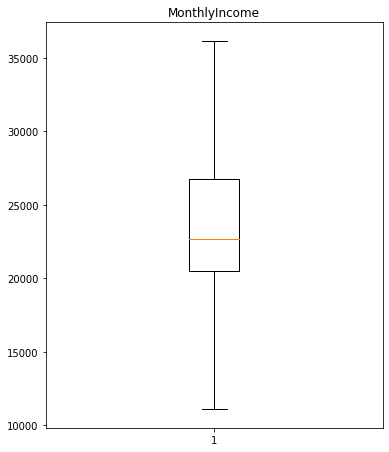

In [88]:
columns = ["MonthlyIncome"]
plt.figure(figsize=(20,30))

for i, variable in enumerate(columns):
                     plt.subplot(5,4,i+1)
                     plt.boxplot(customerData[variable],whis=1.5)
                     plt.tight_layout()
                     plt.title(variable)

plt.show()

`MonthlyIncome` has no outliers now. 

**Treat `DurationOfPitch` Outliers**

In [89]:
## As explianed above, I am going to take mean and replace the 2 very extreme values of Duration of Pitch (126 & 127). 

meanDuration = customerData["DurationOfPitch"].mean()

customerData["DurationOfPitch"] = customerData["DurationOfPitch"].apply(lambda x: meanDuration if x > 100 else x)

customerData[customerData["DurationOfPitch"] > 100].head()

,ProdTaken,Age,TypeofContact,CityTier,DurationOfPitch,Occupation,Gender,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,MaritalStatus,NumberOfTrips,Passport,PitchSatisfactionScore,OwnCar,MonthlyIncome


**Convert Catarogical columns into Numerical Values**

In [90]:
replaceStruct = {
                "Occupation": {"Salaried": 1, "Small Business":2 , "Large Business": 3},
                "ProductPitched": {"Deluxe": 1, "Basic": 2 , "Standard": 3, "Super Deluxe": 4,"King": 5}
                }
oneHotCols=["Gender","MaritalStatus","TypeofContact"]

In [91]:
customerData=customerData.replace(replaceStruct)
customerData=pd.get_dummies(customerData, columns=oneHotCols)
customerData.head(10)

,ProdTaken,Age,CityTier,DurationOfPitch,Occupation,NumberOfPersonVisiting,NumberOfFollowups,ProductPitched,PreferredPropertyStar,NumberOfTrips,...,PitchSatisfactionScore,OwnCar,MonthlyIncome,Gender_Female,Gender_Male,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Unmarried,TypeofContact_Company Invited,TypeofContact_Self Enquiry
0,1,41.000000,3,6.0,1,3,3.0,1,3.0,1.0,...,2,1,20993.0,1,0,0,0,1,0,1
1,0,49.000000,1,14.0,1,3,4.0,1,4.0,2.0,...,3,1,20130.0,0,1,1,0,0,1,0
3,0,33.000000,1,9.0,1,2,3.0,2,3.0,2.0,...,5,1,17909.0,1,0,1,0,0,1,0
4,0,37.319986,1,8.0,2,2,3.0,2,4.0,1.0,...,5,1,18468.0,0,1,1,0,0,0,1
5,0,32.000000,1,8.0,1,3,3.0,2,3.0,1.0,...,5,1,18068.0,0,1,0,0,1,1,0
6,0,59.000000,1,9.0,2,2,2.0,2,5.0,5.0,...,2,1,17670.0,1,0,1,0,0,0,1
7,0,30.000000,1,30.0,1,3,3.0,2,3.0,2.0,...,2,0,17693.0,0,1,0,1,0,0,1
8,0,38.000000,1,29.0,1,2,4.0,3,3.0,1.0,...,3,0,24526.0,0,1,0,0,1,1,0
9,0,36.000000,1,33.0,2,3,3.0,1,3.0,7.0,...,3,1,20237.0,0,1,1,0,0,0,1
10,0,35.000000,1,22.0,2,2,2.0,2,4.0,1.0,...,3,1,17426.0,0,1,1,0,0,0,1


In [92]:
customerData.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4886 entries, 0 to 4887
Data columns (total 21 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   ProdTaken                      4886 non-null   int64  
 1   Age                            4886 non-null   float64
 2   CityTier                       4886 non-null   int64  
 3   DurationOfPitch                4886 non-null   float64
 4   Occupation                     4886 non-null   int64  
 5   NumberOfPersonVisiting         4886 non-null   int64  
 6   NumberOfFollowups              4886 non-null   float64
 7   ProductPitched                 4886 non-null   int64  
 8   PreferredPropertyStar          4886 non-null   float64
 9   NumberOfTrips                  4886 non-null   float64
 10  Passport                       4886 non-null   int64  
 11  PitchSatisfactionScore         4886 non-null   int64  
 12  OwnCar                         4886 non-null   i

#### This concludes data preparation step. 

### Functions used throught out model building. 

In [93]:
## I copied this function from my previous assignment submission. 

def calculate_model_score(model,train,test,train_y,test_y, preferredSolver ,threshold=0.5,flag=True,roc=False):
    '''
    Function to calculate different metric scores of the model - Accuracy, Recall, Precision, and F1 score
    model: classifier to predict values of X
    train, test: Independent features
    train_y,test_y: Dependent variable
    threshold: thresold for classifiying the observation as 1
    flag: If the flag is set to True then only the print statements showing different will be displayed. The default value is set to True.
    roc: If the roc is set to True then only roc score will be displayed. The default value is set to False.
    '''
    # defining an empty list to store train and test results
    
    score_list=[] 
    
    pred_train = (model.predict_proba(train)[:,1]>threshold)
    pred_test = (model.predict_proba(test)[:,1]>threshold)

    pred_train = np.round(pred_train)
    pred_test = np.round(pred_test)
    
    train_acc = accuracy_score(pred_train,train_y)
    test_acc = accuracy_score(pred_test,test_y)
    
    train_recall = recall_score(train_y,pred_train)
    test_recall = recall_score(test_y,pred_test)
    
    train_precision = precision_score(train_y,pred_train)
    test_precision = precision_score(test_y,pred_test)
    
    train_f1 = f1_score(train_y,pred_train)
    test_f1 = f1_score(test_y,pred_test)
    
    
    score_list.extend((train_acc,test_acc,train_recall,test_recall,train_precision,test_precision,train_f1,test_f1))
        
    
    if flag == True: 
        print("Accuracy on training set using  : ", preferredSolver , " with threshold ", threshold, " is -- " ,accuracy_score(pred_train,train_y))
        print("Accuracy on test set using : ", preferredSolver ," with threshold ", threshold,  " is -- " ,accuracy_score(pred_test,test_y))
        print("Recall on training set using : ",preferredSolver , " with threshold ", threshold, " is -- " ,recall_score(train_y,pred_train))
        print("Recall on test set using : ", preferredSolver , " with threshold ", threshold, " is -- " ,recall_score(test_y,pred_test))
        print("Precision on training set using : ", preferredSolver ," with threshold ", threshold,  " is -- " ,precision_score(train_y,pred_train))
        print("Precision on test set using : ",preferredSolver , " with threshold ", threshold, " is -- " ,precision_score(test_y,pred_test))
        print("F1 on training set using : ", preferredSolver , " with threshold ", threshold, " is -- " ,f1_score(train_y,pred_train))
        print("F1 on test set using : ", preferredSolver , " with threshold ", threshold, " is -- " ,f1_score(test_y,pred_test))
        print("************************************************************************************************************")
        print("")
   
    if roc == True:
        pred_train_prob = model.predict_proba(train)[:,1]
        pred_test_prob = model.predict_proba(test)[:,1]
        print("ROC-AUC Score on training set : ",roc_auc_score(train_y,pred_train))
        print("ROC-AUC Score on test set : ",roc_auc_score(test_y,pred_test))
        print("************************************************************************************************************")
        print("")
    
   
    
    return score_list # returning the list with train and test scores


In [94]:
def create_confusion_matrix(model,test_X,y_actual,preferredSolver=None,labels=[1, 0]):
    '''
    model : classifier to predict values of X
    test_X: test set
    y_actual : ground truth  
    
    '''
    y_predict = model.predict(test_X)
    cm=metrics.confusion_matrix( y_actual, y_predict, labels=[1,0])
    df_cm = pd.DataFrame(cm, index = [i for i in ["Actual - Yes","Actual - No"]],
                  columns = [i for i in ["Predicted - Yes","Predicted - No"]])
    group_counts = ["{0:0.0f}".format(value) for value in
                cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in
              zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=labels,fmt='')
    plt.ylabel('True label')
    if (preferredSolver == None) :
            plt.xlabel('Predicted label')
    else :                   
        plt.xlabel('Predicted label - For solver - ' + preferredSolver)

In [95]:
def get_feature_importance(classifier, dfColumns):
    importances = classifier.feature_importances_
    indices = np.argsort(importances)
    feature_names = list(dfColumns)

    plt.figure(figsize=(12,12))
    plt.title('Feature Importances')
    plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
    plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
    plt.xlabel('Relative Importance')
    plt.show()

In [96]:
## Defining an array to hold all the models to compare their score later on. 

models = []

In [113]:
def getBestEstimatorUsingGridSearch(classifier, parameters, X_train,y_train):
    # Type of scoring used to compare parameter combinations
    acc_scorer = metrics.make_scorer(metrics.recall_score)

    # Run the grid search
    grid_obj = GridSearchCV(classifier, parameters, scoring=acc_scorer,cv=5)
    grid_obj = grid_obj.fit(X_train, y_train)

    # Set the clf to the best combination of parameters
    classifier = grid_obj.best_estimator_

    # Fit the best algorithm to the data.
    classifier.fit(X_train, y_train)

    models.append(classifier)
    return classifier

In [98]:
## Getting the ratio Target Variable. (That is ration of customer who took loan in the overall customer base. Our training and test datasets should maintain the same ratio)

print(len(customerData[customerData["ProdTaken"] == 1].index)/len(customerData[customerData["ProdTaken"] == 0].index))


0.2313508064516129


This indicates the dataset is imbalanced and we need to make sure to use the same/similar ration in training & test dataset.

**Splitting the dataset into training & testing in the ration of 70:30.**

In [100]:
X = customerData.drop("ProdTaken" , axis=1)
y = customerData.pop("ProdTaken")

## Splitting customer data with Stratify  
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.30, random_state=1,stratify=y)


## 6) Model Building - Bagging

- We are going to build 2 ensemble models here - Bagging Classifier and Random Forest Classifier.
    
- First, let's build these models with default parameters and then use hyperparameter tuning to optimize the model performance.
    
- We will calculate all three metrics - Accuracy, Precision and Recall but the metric of interest here is recall.
    
- `Recall` - It gives the ratio of True positives to Actual positives, so high Recall implies low false negatives, i.e. low chances of predicting a defaulter as non defaulter

### Bagging Classifier - Default Parameters

In [101]:
#base_estimator for bagging classifier is a DecisionTreeClassifier. by default

classifierName = "Bagging Classifier - Default Parameters"
baggingClassifier=BaggingClassifier(random_state=1)
baggingClassifier.fit(X_train,y_train)

models.append(baggingClassifier)

In [102]:
#Check the accuracy, recall and precision on train and test set
baggingClassifier_score=calculate_model_score(baggingClassifier, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

Accuracy on training set using  :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.9915204678362574
Accuracy on test set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.9154160982264665
Recall on training set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.9595645412130638
Recall on test set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.6036363636363636
Precision on training set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.9951612903225806
Precision on test set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.9171270718232044
F1 on training set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.9770387965162313
F1 on test set using :  Bagging Classifier - Default Parameters  with threshold  0.5  is --  0.7280701754385965
*****************************************************

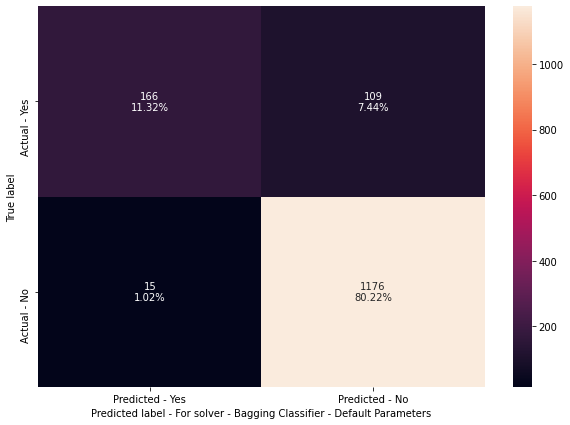

In [103]:
create_confusion_matrix(baggingClassifier ,X_test,y_test,classifierName)

## Observations on Bagging Classifier with Default Parameters -  Score & Confusion Metrix

- Accuracy on training dataset of .99 and .91 on testing dataset, indicates that Model is definetly overfitting. 

- Recall on training is .95 but .60 on testing dataset. 

- Same trend is observed on precision as well. Precision on training dataset is very high .99 but on testing its .91. 

- In general model does a good job in identifying True Negatives, but does poorly in identifying True Positives. 

- Model did a really good job in putting false positives very low. 

- Model also gave few False Negatives. There is some opportunity for model to improve and bring False Negatives lower.

Note - Bagging Classifier as Feature attributes, hence feature importance is not possible on it. 

### Random Forest Classifier  - Default Parameters. 

In [105]:
#Create & Train a default Random Forest Classifier
classifierName = "Random Forest Classifier - Default Parameters"
randomForestClassifier=RandomForestClassifier(random_state=1)
randomForestClassifier.fit(X_train,y_train)

models.append(randomForestClassifier)

In [106]:
#Check the accuracy, recall and precision on train and test set
randomForestClassifier_score=calculate_model_score(randomForestClassifier, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

Accuracy on training set using  :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  1.0
Accuracy on test set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  0.902455661664393
Recall on training set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  1.0
Recall on test set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  0.5127272727272727
Precision on training set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  1.0
Precision on test set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  0.94
F1 on training set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  1.0
F1 on test set using :  Random Forest Classifier - Default Parameters  with threshold  0.5  is --  0.6635294117647058
********************************************************************************

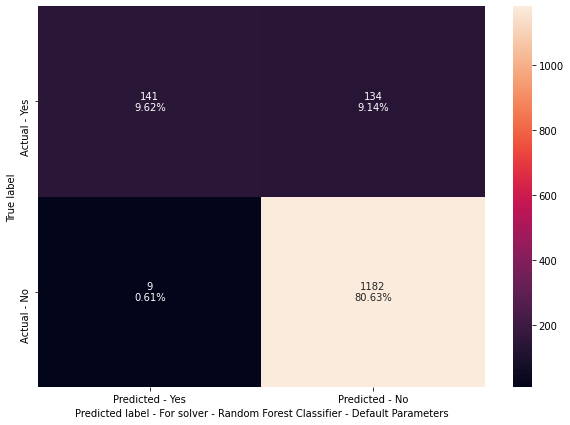

In [107]:
create_confusion_matrix(randomForestClassifier ,X_test,y_test,classifierName)

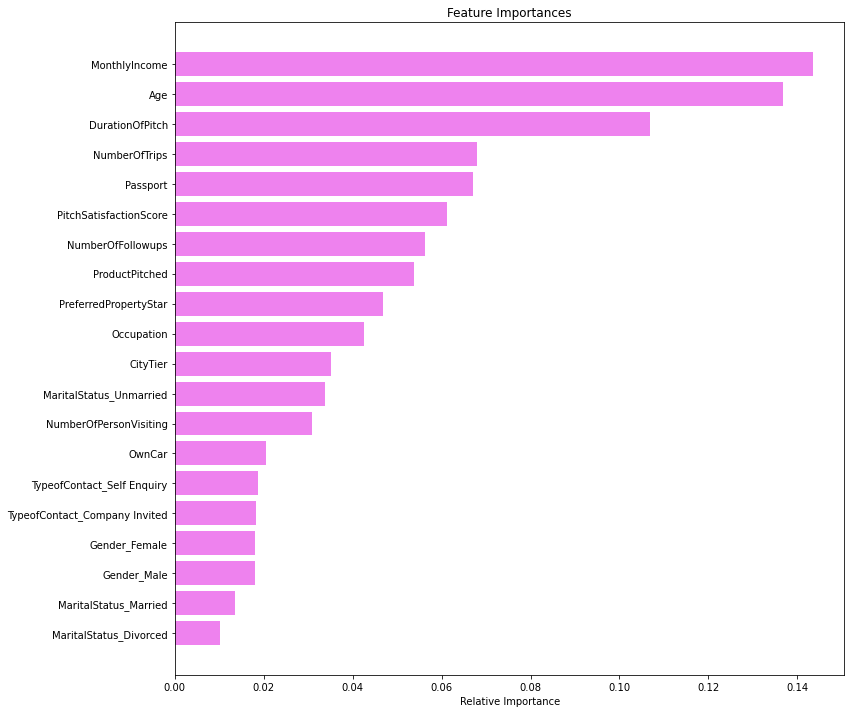

In [108]:
get_feature_importance(randomForestClassifier, X_test.columns)

## Observations on Random Forest Classifier with Default Parameters -  Score , Confusion Metrix and Important Features

- Accuracy on training dataset of 1 and .90 on testing dataset, indicates that Model is definetly overfitting. 

- Recall on training is 1 but .51 on testing dataset. 

- Same trend is observed on precision as well. Precision on training dataset is very high 1 but on testing its .94. 

- In general model does a good job in identifying True Negatives, but does poorly in identifying True Positives. 

- Model did a really good job in putting false positives very low. 

- Model also gave lot of False Negatives. There is some opportunity for model to improve and bring False Negatives lower.

- Monthly Income appears to be the most important feature, followed by Age & DurationOfPitch. Marital Status & Gender are the least important features according to RandomForest Classifier. 

**In generall comparing with Bagging Classifier with default parameters, Random Forest performed poorly. It overfitted and gave lesser Recall value.**

## Tunning Hyperparameters 

### Bagging Classifier

**Some of the important hyperparameters available for bagging classifier are:**

- base_estimator: The base estimator to fit on random subsets of the dataset. If None(default), then the base estimator is a decision tree.
- n_estimators: The number of trees in the forest, default = 100.
- max_features: The number of features to consider when looking for the best split. 
- bootstrap: Whether bootstrap samples are used when building trees. If False, the entire dataset is used to build each tree, default=True.
- bootstrap_features: If it is true, then features are drawn with replacement. Default value is False.
- max_samples: If bootstrap is True, then the number of samples to draw from X to train each base estimator. If None (default), then draw N samples, where N is the number of observations in the train data.
- oob_score: Whether to use out-of-bag samples to estimate the generalization accuracy, default=False.

In [109]:
# Choose the type of classifier. 

classifierName = "baggingClassifier_tuned"

baggingClassifier_tuned = BaggingClassifier(random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {'max_samples': [0.7,0.8,0.9,1], 
              'max_features': [0.7,0.8,0.9,1],
              'n_estimators' : [10,20,30,40,50,100],
              'bootstrap_features': [True,False],
              'oob_score': [True, False]
             }

baggingClassifier_tuned = getBestEstimatorUsingGridSearch(baggingClassifier_tuned, parameters, X_train,y_train)

**Let's check different metrics for bagging classifier with best hyperparameters and build a confusion matrix.**

In [117]:
#Using above defined function to get accuracy, recall and precision on train and test set
baggingEstimator_tuned_score=calculate_model_score(baggingClassifier_tuned, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

Accuracy on training set using  :  baggingClassifier_tuned  with threshold  0.5  is --  0.9994152046783625
Accuracy on test set using :  baggingClassifier_tuned  with threshold  0.5  is --  0.9181446111869032
Recall on training set using :  baggingClassifier_tuned  with threshold  0.5  is --  0.9968895800933126
Recall on test set using :  baggingClassifier_tuned  with threshold  0.5  is --  0.6072727272727273
Precision on training set using :  baggingClassifier_tuned  with threshold  0.5  is --  1.0
Precision on test set using :  baggingClassifier_tuned  with threshold  0.5  is --  0.9329608938547486
F1 on training set using :  baggingClassifier_tuned  with threshold  0.5  is --  0.9984423676012462
F1 on test set using :  baggingClassifier_tuned  with threshold  0.5  is --  0.73568281938326
************************************************************************************************************



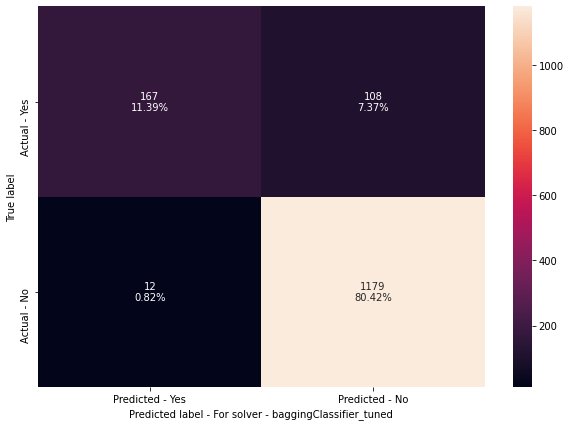

In [118]:
create_confusion_matrix(baggingClassifier_tuned,X_test,y_test,classifierName)

### Observations on Bagging Classifier with Tuned Hyperparameters - Score & Confusion Matrix  

- Accuracy on training dataset of .99 and .91 on testing dataset, indicates that Model is definetly overfitting. 

- Recall on training is .99 but .60 on testing dataset. 

- Same trend is observed on precision as well. Precision on training dataset is very high 1 but on testing its .93. 

- Model did an excellent job in identifying True Negatives.

- Model did a really good job in putting false positives very low. 

- Model also gave few False Negatives. There is some opportunity for model to improve and bring False Negatives lower.

**In generall comparing with Bagging Classifier with tuned Hyperparameters didn't fair any significantly better, Bagging Classifier with default parameters**

### Bagging Classifier with LogisticRegression as Base Estimator - Default Parameters

In [119]:
classifierName = "BaggingClassifier with LogisticRegression"

baggingClassifier_logit=BaggingClassifier(base_estimator=LogisticRegression(random_state=1),random_state=1)

baggingClassifier_logit.fit(X_train,y_train)

models.append(baggingClassifier_logit)

In [120]:
#Using above defined function to get accuracy, recall and precision on train and test set
baggingClassifier_logit_score=calculate_model_score(baggingClassifier_logit, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

Accuracy on training set using  :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.8400584795321637
Accuracy on test set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.8315143246930423
Recall on training set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.17729393468118196
Recall on test set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.14181818181818182
Precision on training set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.8636363636363636
Precision on test set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.78
F1 on training set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.29419354838709677
F1 on test set using :  BaggingClassifier with LogisticRegression  with threshold  0.5  is --  0.24
**************************************************************

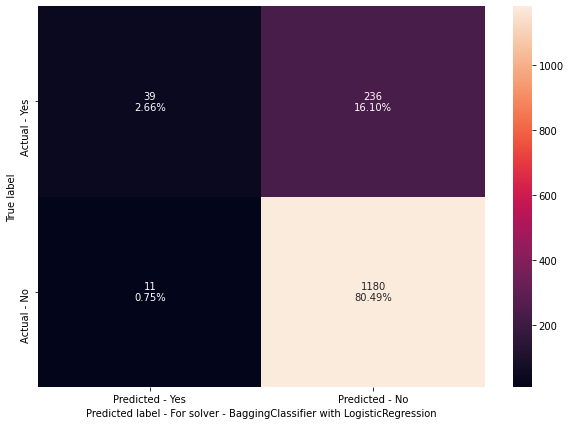

In [121]:
create_confusion_matrix(baggingClassifier_logit,X_test,y_test,classifierName)

### Observations on Bagging Classifier with Logistic Regression - Score & Confusion Matrix  

- Accuracy on training dataset of .84 and .83 on testing dataset, indicates that Model didn't overfit. 

- Recall on training is .177 but .14 on testing dataset. Recall score is very low. 

- Precision is found low as well at .86 for training dataset is .78 on testing dataset.  

- In general model does a good job in identifying True Negatives, but does poorly in identifying True Positives. 

- Model did a really good job in putting false positives very low. 

- Model gave a lot of False Negatives. This model is definetly not a good fit for calculating odds of customers buying a product. 

**In generall comparing with Bagging Classifier with LogisticRegression did very poorly on all aspects.**

### Bagging Classifier with LogisticRegression as Base Estimator - Tuned Hyperparmeters

In [122]:
classifierName = "baggingClassifier_logit_tuned"

baggingClassifier_logit_tuned = BaggingClassifier(base_estimator=LogisticRegression(random_state=1),random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {'max_samples': [0.7,0.8,0.9,1], 
              'max_features': [0.7,0.8,0.9,1],
              'n_estimators' : [10,20,30,40,50,100],
              'bootstrap_features': [True,False],
              'oob_score': [True, False]
             }

baggingClassifier_logit_tuned = getBestEstimatorUsingGridSearch(baggingClassifier_logit_tuned, parameters, X_train,y_train)
print(baggingClassifier_logit_tuned)

BaggingClassifier(base_estimator=LogisticRegression(random_state=1),
                  max_features=0.9, max_samples=0.8, oob_score=True,
                  random_state=1)


Accuracy on training set using  :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.8330409356725146
Accuracy on test set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.8274215552523875
Recall on training set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.12597200622083982
Recall on test set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.10909090909090909
Precision on training set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.9
Precision on test set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.7894736842105263
F1 on training set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.22100954979536155
F1 on test set using :  baggingClassifier_logit_tuned  with threshold  0.5  is --  0.19169329073482425
************************************************************************************************************



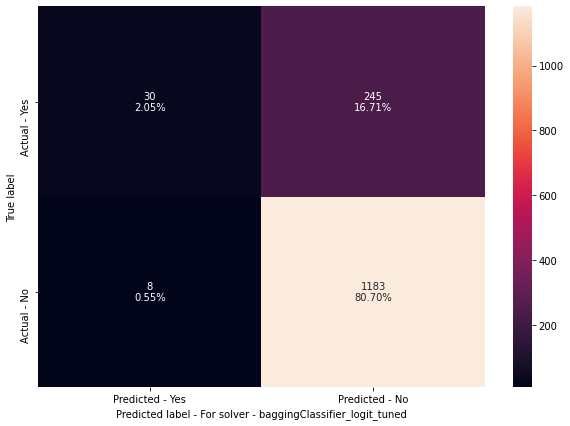

In [124]:
#Using above defined function to get accuracy, recall and precision on train and test set
baggingClassifier_logit_tuned_score=calculate_model_score(baggingClassifier_logit_tuned, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

create_confusion_matrix(baggingClassifier_logit_tuned,X_test,y_test,classifierName)

### Observations on Bagging Classifier with Logistic Regression and Tuned Hyperparameters - Score & Confusion Matrix  

- Accuracy on training dataset of .83 and .83 on testing dataset, indicates that Model didn't overfit. 

- Recall on training is .12 but only .10 on testing dataset. Recall score continues to be very poor. 

- Precision on training dataset is .9 but on testing its 0.78 

- In general model does a good job in identifying True Negatives, but does very poorly in identifying True Positives. 

- Model did a really good job in putting false positives very low. 

- Model gave too many of False Negatives, which is bad, since these are primarly the customers company wants to identify. Therefore this. model is not good for the use case. 

**In general comparing with Bagging Classifier with LogisticRegression and Tuned Hyperparameter did very poor in all the aspect and can't be used.**

### Tunning Hyperparameters Random Forest Classifier
**Now, let's see if we can get a better model by tuning the random forest classifier. Some of the important hyperparameters available for random forest classifier are:**

- n_estimators: The number of trees in the forest, default = 100.
- max_features: The number of features to consider when looking for the best split. 
- class_weight: Weights associated with classes in the form {class_label: weight}.If not given, all classes are supposed to have weight one.  
- For example: If the frequency of class 0 is 80% and the frequency of class 1 is 20% in the data, then class 0 will become the dominant class and the model will become biased toward the dominant classes. In this case, we can pass a dictionary {0:0.2,1:0.8} to the model to specify the weight of each class and the random forest will give more weightage to class 1. 
- bootstrap: Whether bootstrap samples are used when building trees. If False, the entire dataset is used to build each tree, default=True.
- max_samples: If bootstrap is True, then the number of samples to draw from X to train each base estimator. If None (default), then draw N samples, where N is the number of observations in the train data.
- oob_score: Whether to use out-of-bag samples to estimate the generalization accuracy, default=False.

- Note: A lot of hyperparameters of Decision Trees are also available to tune  Random Forest like max_depth, min_sample_split etc.

In [125]:
# Choose the type of classifier. 

classifierName = "randomEstimator_estimator_tuned"
randomEstimator_estimator_tuned = RandomForestClassifier(random_state=1)

parameters = {"n_estimators": [150,200,250],
    "min_samples_leaf": np.arange(5, 10),
    "max_features": np.arange(0.2, 0.7, 0.1),
    "max_samples": np.arange(0.3, 0.7, 0.1),
             }

randomEstimator_estimator_tuned = getBestEstimatorUsingGridSearch(randomEstimator_estimator_tuned, parameters, X_train,y_train)

Accuracy on training set using  :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.9076023391812865
Accuracy on test set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.8628922237380627
Recall on training set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.5489891135303266
Recall on test set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.3563636363636364
Precision on training set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.9313984168865436
Precision on test set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.8032786885245902
F1 on training set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.6908023483365949
F1 on test set using :  randomEstimator_estimator_tuned  with threshold  0.5  is --  0.49370277078085645
************************************************************************************************************



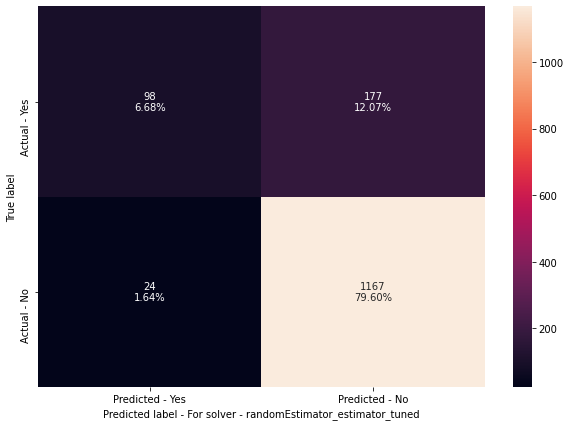

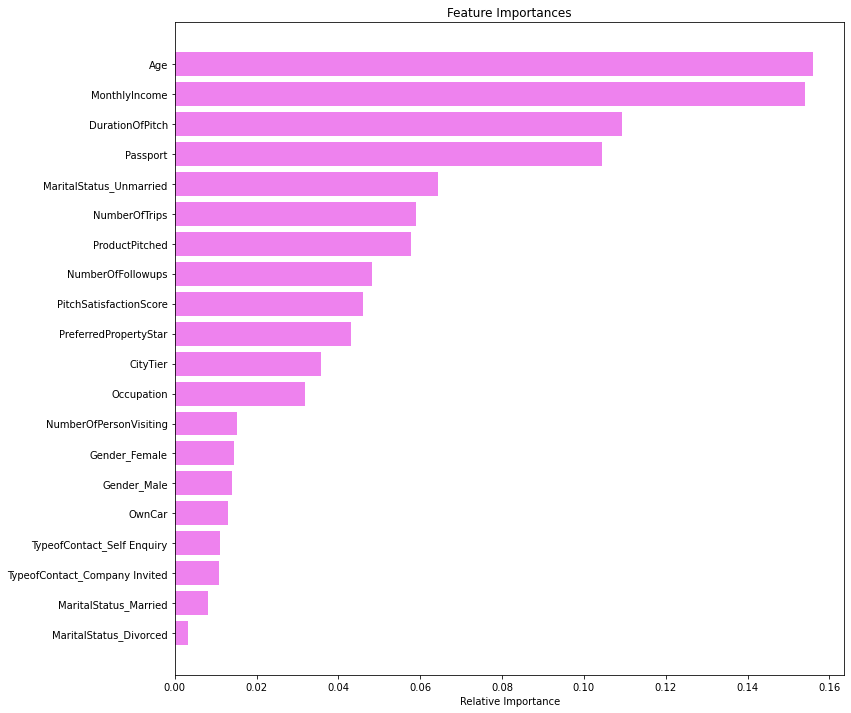

In [126]:
#Using above defined function to get accuracy, recall and precision on train and test set
randomEstimator_estimator_tuned_score=calculate_model_score(randomEstimator_estimator_tuned, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

create_confusion_matrix(randomEstimator_estimator_tuned,X_test,y_test,classifierName)

get_feature_importance(randomEstimator_estimator_tuned, X_test.columns)

### Observations on Random Forest with Tuned Hyperparameters - Score, Confusion Matrix  and Feature Importance

- Accuracy on training dataset of .90 and .86 on testing dataset, indicates that Model slightly overfit. 

- Recall on training is .54 but .35 on testing dataset. Recall score is much better compare after tuning Hyperparameters, but its stil significantly low compare to recall on training dataset.  

- Same trend is observed on precision as well. Precision on training dataset is .93 but on testing its 0.80 

- In general model does a good job in identifying True Negatives, but does poorly in identifying True Positives. 

- Model had low false positives, but still higher than RandomForest Classifier with default parameters. 

- Model gave a lot of False Negatives. 

- `Age`, `MonthlyIncome` & `DurationOfPitch` appears to be the top 3 important features. This is in line with plain RandomForest classifier. Similarly `Marital Status` is least important Feature. 

**In general Random Forest classifier with tunned Hyperparameters didn't do well compare to the classifier default parameters.**

### Random Forest using class_weights :

- Let's assign weight to the class and check if that makes a difference in model performance. 

- Inital data was found imbalanced with less than 30% customers didn't buy a travel package. 

- We can choose class_weights={0:0.3,1:0.7} because that is the original imbalance in our data.

In [128]:
# Choose the type of classifier. 

classifierName = "randomForestEstimator_tuned_weighted"
randomForestEstimator_tuned_weighted = RandomForestClassifier(random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    "class_weight": [{0: 0.3, 1: 0.7}],
    "n_estimators": [100,150,200,250],
    "min_samples_leaf": np.arange(5, 10),
    "max_features": np.arange(0.2, 0.7, 0.1),
    "max_samples": np.arange(0.3, 0.7, 0.1),
}

randomForestEstimator_tuned_weighted = getBestEstimatorUsingGridSearch(randomForestEstimator_tuned_weighted, parameters, X_train,y_train)

In [129]:
print(randomForestEstimator_tuned_weighted)

RandomForestClassifier(class_weight={0: 0.3, 1: 0.7},
                       max_features=0.6000000000000001,
                       max_samples=0.6000000000000001, min_samples_leaf=7,
                       n_estimators=250, random_state=1)


Accuracy on training set using  :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.9198830409356725
Accuracy on test set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.869031377899045
Recall on training set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.7169517884914464
Recall on test set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.48727272727272725
Precision on training set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.833634719710669
Precision on test set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.7243243243243244
F1 on training set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.7709030100334447
F1 on test set using :  randomForestEstimator_tuned_weighted  with threshold  0.5  is --  0.5826086956521739
******************************************************************************

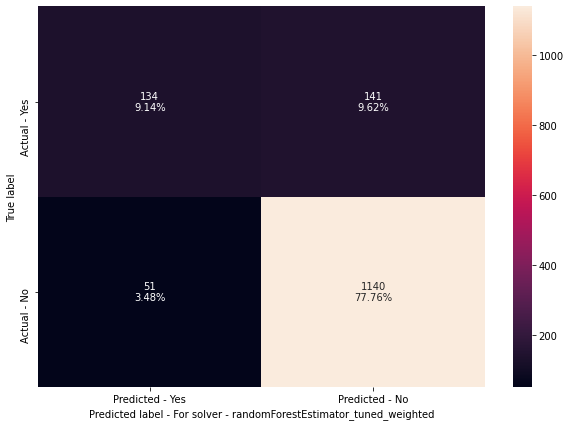

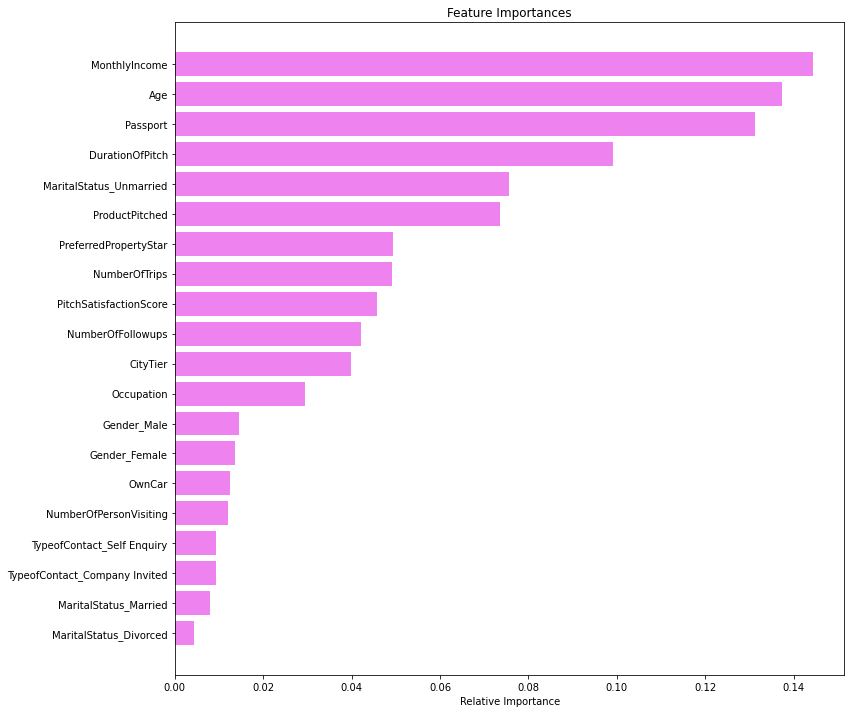

In [130]:
#Using above defined function to get accuracy, recall and precision on train and test set
randomForestEstimator_tuned_weighted_score=calculate_model_score(randomForestEstimator_tuned_weighted, X_train, X_test, y_train, y_test,classifierName,threshold=0.5)

create_confusion_matrix(randomForestEstimator_tuned_weighted,X_test,y_test,classifierName)

get_feature_importance(randomForestEstimator_tuned_weighted, X_test.columns)

### Observations on Random Forest with Weighted Class and Tuned Hyperparameters - Score, Confusion Matrix  & Feature Importance.

- Accuracy on training dataset of .91 and .86 on testing dataset, indicates that Model overfit. 

- Recall on training is .71 but .48 on testing dataset. This is another metrics, that model is overfitting. Recall score is better compare to RandomForest Classifier wihtout weights.

- Same trend is observed on precision as well. Precision on training dataset is .83 but on testing its 0.72 

- Model performance degraded. The True Negatives is lower compare to other versions of RandomForests. 

- Model had low false positives, but still higher than RandomForest Classifier with default parameters. 

- Model gave a lot of False Negatives. 

- `MonthlyIncome`, `Age` & `Passport` are the top 3 important features and Marital Status is the least important feature. 

**In general Random Forest classifier with weigted class gave similar performance compare to other RandomForests classifers.**

### Decision Tree

We have done Random Forest & Bagging classifier as part of this exercise. In this section I would create a Decision Tree and build model to see if that can yeild a better result than Bagging Techniques. 

- For this excercise we will use DecisionTreeClassifier to build the model. 
- For selection criterion we will use both `gini` for calculating Gini Impurity and `entropy' to calculate Information Gain and evaluate which one fits best. 
- We need to provide class weight to treat the bias towards one output class. Here since customer's who didn't accept the Personal Loan offer is much higher than those who don't, we should provide different weight for the two output classes. 
- I wont be doing any feature scaling as it doesn't have any impact on the decision tree split criterion. I will revisit this if visulazation become difficult with high scale. 


#### Building Model

In [185]:
## Function to build a decision tree
def buildDecisionTreeClassiferModel(selectionCriterion, classWeight):
    model = DecisionTreeClassifier(criterion=selectionCriterion, class_weight=classWeight, random_state=1)
    return model
## Function to calculate Recall for Decision Tree

def calculate_Recall(model, modelName=None) :
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)
    if modelName :
        print(f'For Model - {modelName}')
    print("\tRecall on training set : ", metrics.recall_score(y_train, pred_train))
    print("\tRecall on test set : ", metrics.recall_score(y_test, pred_test))
    print('******************************************************************************')


**Gini 10-90/20-80 and Entropy 10-90/20-80**

In [179]:
model_gini_10_90 = buildDecisionTreeClassiferModel("gini", {0: 0.10, 1: 0.90})    
model_gini_20_80 = buildDecisionTreeClassiferModel("gini", {0: 0.20, 1: 0.80})   
model_entropy_10_90 = buildDecisionTreeClassiferModel("entropy", {0: 0.10, 1: 0.90})   
model_entropy_20_80 = buildDecisionTreeClassiferModel("entropy", {0: 0.20, 1: 0.80})   

##Fitting all the models 
model_gini_10_90.fit(X_train, y_train)
model_gini_20_80.fit(X_train, y_train)
model_entropy_10_90.fit(X_train, y_train)
model_entropy_20_80.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.2, 1: 0.8}, criterion='entropy',
                       random_state=1)

**Performance measuring and Selecting the best model from the above**


				Confusion Metrix for model - model_gini_10_90


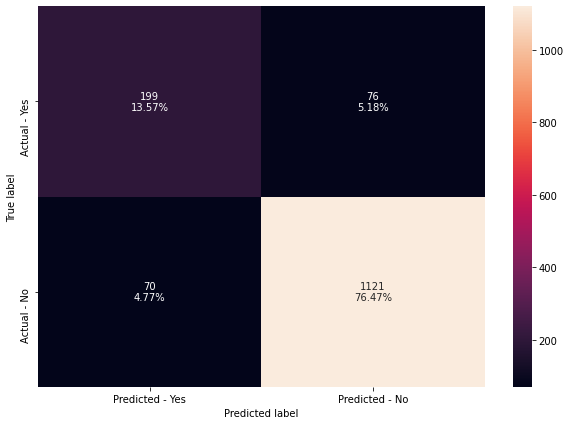

In [180]:
print('\n\t\t\t\tConfusion Metrix for model - model_gini_10_90')
create_confusion_matrix(model_gini_10_90,X_test,y_test, labels=[1, 0])


				Confusion Metrix for model - model_gini_20_80


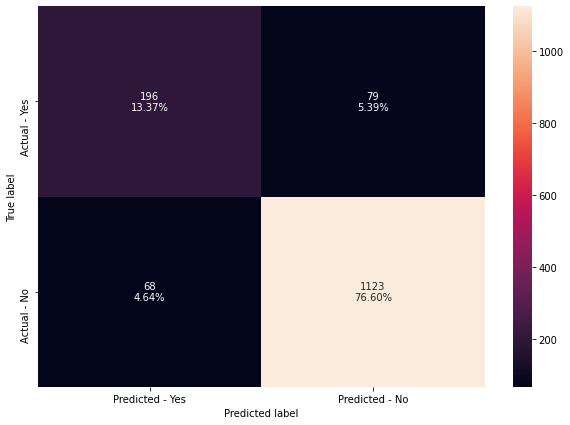

In [181]:
print('\n\t\t\t\tConfusion Metrix for model - model_gini_20_80')
create_confusion_matrix(model_gini_20_80,X_test,y_test, labels=[1, 0])


				Confusion Metrix for model - model_entropy_10_90


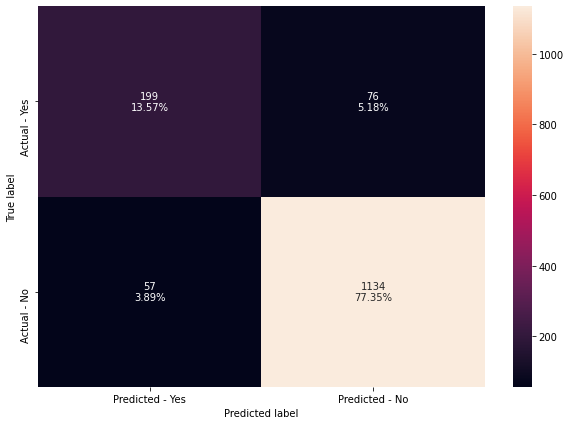

In [182]:
print('\n\t\t\t\tConfusion Metrix for model - model_entropy_10_90')
create_confusion_matrix(model_entropy_10_90,X_test,y_test, labels=[1, 0])


				Confusion Metrix for model - model_entropy_20_80


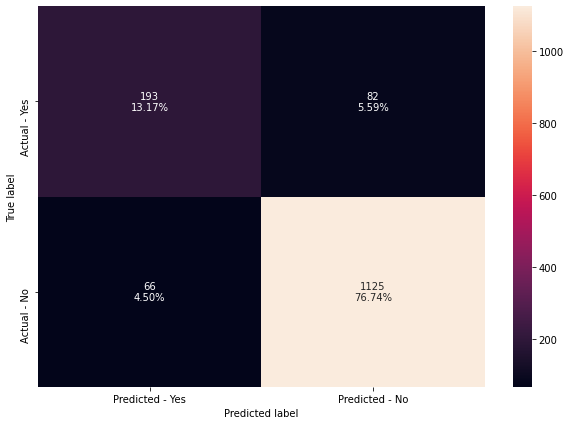

In [183]:
print('\n\t\t\t\tConfusion Metrix for model - model_entropy_20_80')
create_confusion_matrix(model_entropy_20_80,X_test,y_test, labels=[1, 0])

In [186]:
calculate_Recall(model_gini_10_90, "model_gini_10_90")
calculate_Recall(model_gini_20_80, "model_gini_20_80")
calculate_Recall(model_entropy_10_90, "model_entropy_10_90")
calculate_Recall(model_entropy_20_80, "model_entropy_20_80")

For Model - model_gini_10_90
	Recall on training set :  1.0
	Recall on test set :  0.7236363636363636
******************************************************************************
For Model - model_gini_20_80
	Recall on training set :  1.0
	Recall on test set :  0.7127272727272728
******************************************************************************
For Model - model_entropy_10_90
	Recall on training set :  1.0
	Recall on test set :  0.7236363636363636
******************************************************************************
For Model - model_entropy_20_80
	Recall on training set :  1.0
	Recall on test set :  0.7018181818181818
******************************************************************************


***Based on the Recall Metrics above, our models are doing fairly good. Recall of test data is lesser than training data for all combination of Gini & Entropy criterion. Model with `Entropy` selection criterion and class weight of `{0:.10,1:.90}` is giving the maximum Recall on test data, and I will use that for creating Decision Tree.***

Note* - Since this is for acedamics purpose, my intentions were to show various models and choose the best among them.

In [187]:
selectedModel = model_entropy_10_90 # We are selecting the model here, and use this for Building Decision tree and further analysis

### Building & Visualizing the Decision Tree

In [188]:
def visualizeDecisionTree(model,features_names) :
    plt.figure(figsize=(20, 30))
    out = tree.plot_tree(
        model,
        feature_names=feature_names,
        filled=True,
        fontsize=9,
        node_ids=False,
        class_names=None,
    )
    # below code will add arrows to the decision tree split if they are missing
    for o in out:
        arrow = o.arrow_patch
        if arrow is not None:
            arrow.set_edgecolor("black")
            arrow.set_linewidth(1)
    plt.show()

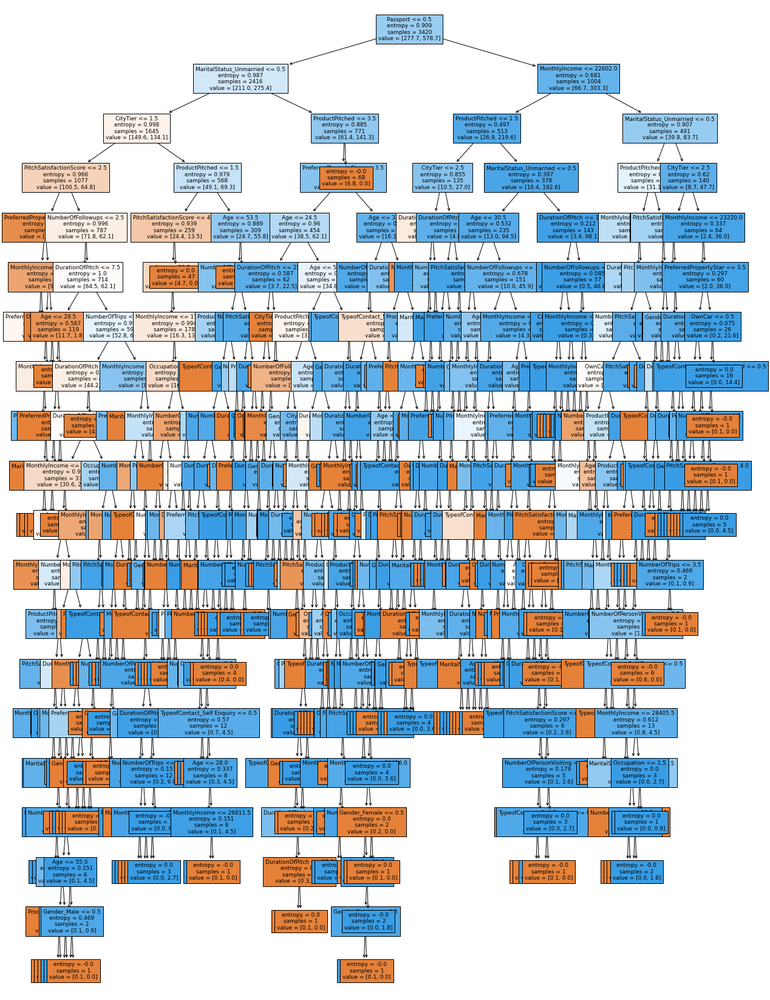

In [192]:
feature_names = list(X_train.columns)
visualizeDecisionTree(selectedModel,feature_names)

In [193]:
print(tree.export_text(selectedModel, feature_names=feature_names, show_weights=True))

|--- Passport <= 0.50
|   |--- MaritalStatus_Unmarried <= 0.50
|   |   |--- CityTier <= 1.50
|   |   |   |--- PitchSatisfactionScore <= 2.50
|   |   |   |   |--- PreferredPropertyStar <= 3.50
|   |   |   |   |   |--- Gender_Male <= 0.50
|   |   |   |   |   |   |--- weights: [7.00, 0.00] class: 0
|   |   |   |   |   |--- Gender_Male >  0.50
|   |   |   |   |   |   |--- weights: [12.00, 0.00] class: 0
|   |   |   |   |--- PreferredPropertyStar >  3.50
|   |   |   |   |   |--- MonthlyIncome <= 20902.00
|   |   |   |   |   |   |--- PreferredPropertyStar <= 4.50
|   |   |   |   |   |   |   |--- Age <= 26.00
|   |   |   |   |   |   |   |   |--- weights: [0.00, 1.80] class: 1
|   |   |   |   |   |   |   |--- Age >  26.00
|   |   |   |   |   |   |   |   |--- Age <= 51.50
|   |   |   |   |   |   |   |   |   |--- ProductPitched <= 1.50
|   |   |   |   |   |   |   |   |   |   |--- weights: [0.50, 0.00] class: 0
|   |   |   |   |   |   |   |   |   |--- ProductPitched >  1.50
|   |   |   |   |   | 

#### Feature Importance

In [194]:
print(
    pd.DataFrame(
        selectedModel.feature_importances_, columns=["Imp"], index=X_train.columns
    ).sort_values(by="Imp", ascending=False)
)

                                    Imp
MonthlyIncome                  0.143995
Age                            0.143590
DurationOfPitch                0.121445
ProductPitched                 0.095069
NumberOfTrips                  0.080039
PitchSatisfactionScore         0.064006
Passport                       0.059548
PreferredPropertyStar          0.045255
NumberOfFollowups              0.042378
MaritalStatus_Unmarried        0.041365
Occupation                     0.038886
CityTier                       0.029465
Gender_Male                    0.023074
OwnCar                         0.015741
NumberOfPersonVisiting         0.014436
Gender_Female                  0.010096
TypeofContact_Company Invited  0.009476
TypeofContact_Self Enquiry     0.008642
MaritalStatus_Married          0.008032
MaritalStatus_Divorced         0.005462


#### Tunning Decision Tree

In [195]:
descisionTreeClassifier = DecisionTreeClassifier(random_state=1, class_weight={0: 0.10, 1: 0.90})

# Grid of parameters to choose from
parameters = {
    "max_depth": np.arange(1, 10),
    "criterion": ["entropy", "gini"],
    "splitter": ["best", "random"],
    "min_impurity_decrease": [0.000001, 0.00001, 0.0001],
    "max_features": ["log2", "sqrt"],
}

descisionTreeClassifier = getBestEstimatorUsingGridSearch(descisionTreeClassifier, parameters, X_train,y_train)

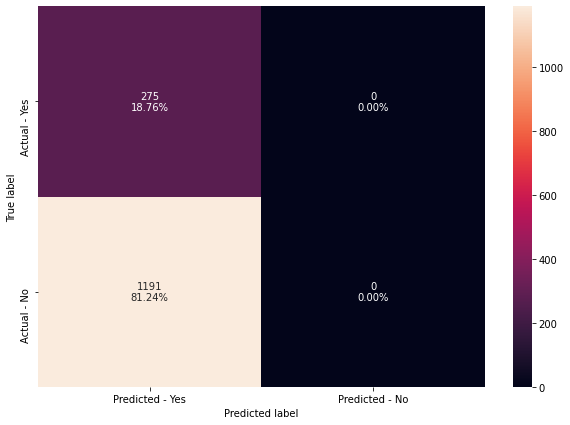

In [197]:
create_confusion_matrix(descisionTreeClassifier,X_test,y_test)

In [198]:
calculate_Recall(descisionTreeClassifier)

	Recall on training set :  1.0
	Recall on test set :  1.0
******************************************************************************


Decision Tree has clearly overfitted. Most of the value Predicted True are actually False Positives. False Postivies can be costly to the company specially if majority of predictions are False Positive. Company will spend all the money and resources target wrong set of customers. 


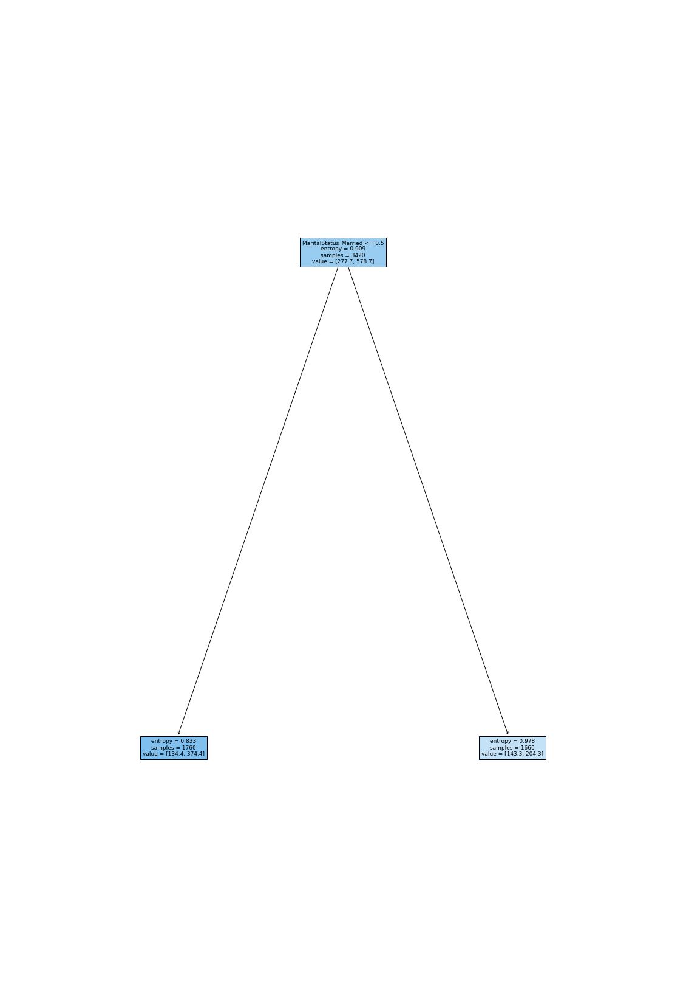

In [200]:
visualizeDecisionTree(descisionTreeClassifier, feature_names)

We got a very simple Decision Tree or I should say Decision Stump. And this explains why Decision Tree is so overfitting. 

For Decision I would stop here, because clearly, Decision Tree wont give us the right results as they tend to overfit very quickly.

**Note** - Reason for me to add decision tree and analyze the results was to make sure we verify Decision Tree results to justify the need of more complex modelling techniques (Bagging & Boosting) for this problem statement. 

Also in the case study, expectations mentio Decision Tree, without providing more details. This is a simplistics exercise to proove the point that Decision Tree isn't a good fit for this use case. 

## 7) Bagging Classifiers - Performance Evaluation 

In [132]:
# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []

# looping through all the models to get the accuracy, precall and precision scores
for model in models:
    j = calculate_model_score(model, X_train, X_test, y_train, y_test, "",flag=False)
    acc_train.append(np.round(j[0],2))
    acc_test.append(np.round(j[1],2))
    recall_train.append(np.round(j[2],2))
    recall_test.append(np.round(j[3],2))
    precision_train.append(np.round(j[4],2))
    precision_test.append(np.round(j[5],2))

In [141]:
comparison_frame = pd.DataFrame({'Model':['Bagging classifier with default parameters','Random Forest Classifier','BaggingClassifier Tuned',
                                        'Bagging classifier with base_estimator=LR', 'Tunned Bagging classifier with base_estimator=LR',
                                         'Tuned Random Forest Classifier','Random Forest with class_weights'], 
                                          'Train_Accuracy': acc_train,'Test_Accuracy': acc_test,
                                          'Train_Recall':recall_train,'Test_Recall':recall_test,
                                          'Train_Precision':precision_train,'Test_Precision':precision_test}) 
comparison_frame

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision
0,Bagging classifier with default parameters,0.99,0.92,0.96,0.60,1.00,0.92
1,Random Forest Classifier,1.00,0.90,1.00,0.51,1.00,0.94
2,BaggingClassifier Tuned,1.00,0.92,1.00,0.61,1.00,0.93
3,Bagging classifier with base_estimator=LR,0.84,0.83,0.18,0.14,0.86,0.78
4,Tunned Bagging classifier with base_estimator=LR,0.83,0.83,0.13,0.11,0.90,0.79
5,Tuned Random Forest Classifier,0.91,0.86,0.55,0.36,0.93,0.80
6,Random Forest with class_weights,0.92,0.87,0.72,0.49,0.83,0.72


### What Metrics to look for ?

Since the objective of the company is to profile the customers that are more likely to buy a travel package, we need a model that predicts positive class (or ProdTaken == 1 in this case). We can afford to have some false positives, but false negative should be as low as possible. False Negative (Customer class that would actually buy a product, but model predicted otherwise) would result in a greater business loss (opportunity loss) and hence will prove very costly. 

So an ideal Model for this problem is the one that gives highest `True Postivie Rate` or `Recall`. Also since reaching out to customers and picthing about products is a cost to company, company wants to put as much focus and efforts on customers that are likey to buy the product. Hence identifying `True Negative Rate` (or `Specificity` == TN/TN+FP) is also very important. 

But between `TPR` & `Specificity`, I would prfer a model that gives a higher `TPR` at a cost of for slightly degraded `Specificity`.

**Evaluating Performance of various Bagging Classifiers.**

- Bagging Classifiers with DecisionTreeClassifier gave the best performance. 
- We get a slightly better perfomance after Hypertuning Bagging Classifer.
- Bagging with Logistic Regression performed very poorly across all metrics (Accuracy, Recall & Precision.)
- RandomForest with default parameters did well compare to Tuned Classifier and with class_weight. But still Bagging gave the best results.

**Best Bagging Classifier.**

  Looking at the performance metrics, it looks like Tuned Bagging Classifier is the best Bagging classifier for the given problem statement. Tuned Bagging Classifier gave the best Recall rate (TPR) with very Specificity (TNR  = 98%). 


**Can we get a better model ?**

So to get a better model, we should aim for higher TPR while also keeping Specifity high. We have tunned important parameters of Bagging Classifier (both for DecisionTreeClassifier & LogisticClassifier). This was the best result we found. We can adjust some more parameter to see if that gives any better resutls, but since the gain in perfomance between untuned Bagging Classifier and Tunned Bagging Classifier, I believe, extremely high computational cost reasons against experimenting more with BaggingClassifier Hyperparameters to get a possible low gain. 

Hence this is the best we can get with the Bagging Classifier. Bagging is a parallel model building mechanism and is not additive. The weight of each classifier (in the case Decision Tree) has same weight. This performance may be a limitation of the fact that bagging is not a additive process. 

We can test with Boosting mechanism to see if we can get a better results than this. Boosting is not only sequential process, where results of one model influence subsequent models, its also additive in a sense that more weights are giving to wrongly predicted rows.

## 8) Model Building - Boosting

### Building Models

    1) I am going to build AdaBoost Classifier, Gradient Boosting Classifer, XGBoost Classifier and Stacked Classifier as part of this steps. 
    
    2) I am going to use default parameters and then tune Hyperparameters to gain some optimization
    
    3) Inorder to evaluate the performance, I will use Accuracy, Precision and Recall metrics. 
    
    4) Recall will be key metrics to measure the model performance. Our aim is to identify as many customers who will buy a product as possible. 

### AdaBoosting without Hypertuning 

**Let's build the Adaboost with Default Parameters, and understand the default parameteres**

**Default Parameters of AdaBoostClassifiers** 

`base_estimatorobject`, default=None
The base estimator from which the boosted ensemble is built. Support for sample weighting is required, as well as proper classes_ and n_classes_ attributes. If None, then the base estimator is DecisionTreeClassifier initialized with max_depth=1.

`n_estimatorsint`, default=50
The maximum number of estimators at which boosting is terminated. In case of perfect fit, the learning procedure is stopped early.

`learning_ratefloat`, default=1.
Weight applied to each classifier at each boosting iteration. A higher learning rate increases the contribution of each classifier. There is a trade-off between the learning_rate and n_estimators parameters.

`algorithm{‘SAMME’, ‘SAMME.R’}`, default=’SAMME.R’
If ‘SAMME.R’ then use the SAMME.R real boosting algorithm. base_estimator must support calculation of class probabilities. If ‘SAMME’ then use the SAMME discrete boosting algorithm. The SAMME.R algorithm typically converges faster than SAMME, achieving a lower test error with fewer boosting iterations.

`random_stateint,` RandomState instance or None, default=None
Controls the random seed given at each base_estimator at each boosting iteration. Thus, it is only used when base_estimator exposes a random_state. Pass an int for reproducible output across multiple function calls. See Glossary.


In [144]:
## Create the AdaBoostClassifier
adaBoostClassifier = AdaBoostClassifier(random_state=1)
adaBoostClassifier.fit(X_train, y_train)
models.append(adaBoostClassifier)

In [145]:
## Calculate AdaBoost model score using different Thresholds 

classifierName = "AdaBoost Classifer with default parameters "

adaBoostClassifierScore = calculate_model_score(adaBoostClassifier, X_train, X_test, y_train, y_test, classifierName, threshold=0.5 )

## Below to iteration of model score calculation is only observe the effect of threshold on model scores. 
calculate_model_score(adaBoostClassifier, X_train, X_test, y_train, y_test, classifierName, threshold=0.4)
calculate_model_score(adaBoostClassifier, X_train, X_test, y_train, y_test, classifierName, threshold=0.3)

Accuracy on training set using  :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.856140350877193
Accuracy on test set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.8424283765347885
Recall on training set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.37947122861586313
Recall on test set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.3018181818181818
Precision on training set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.7240356083086054
Precision on test set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.680327868852459
F1 on training set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.49795918367346936
F1 on test set using :  AdaBoost Classifer with default parameters   with threshold  0.5  is --  0.41813602015113355
********************

[0.18801169590643274,
 0.18758526603001363,
 1.0,
 1.0,
 0.18801169590643274,
 0.18758526603001363,
 0.3165148904750184,
 0.31591039632395174]

**Note**
I decided to use predict_prodba instead of predict, to get the probablity of target variable being 0 or 1 (and have a better control), instead of just 0 or 1. I calculated model performance using varions threshold, and it appears, the lower the threshold is (that is when I relaxed the model), I am biasing it towards Target variable to be 1. This is classic overfitting. 
  
Hence I resorted to Threshold of 0.5, which means if the probability of Target variable to be 1 is above 0.5, I consider that to be predicted as 1. 
  
We can model more stricter by increasing the tolerance, but for our use case, I think 0.5 seems to be a reasonable value. 

***With Threshold = 0.5, the model is not overfitting, but recall on test data is quite low .30***

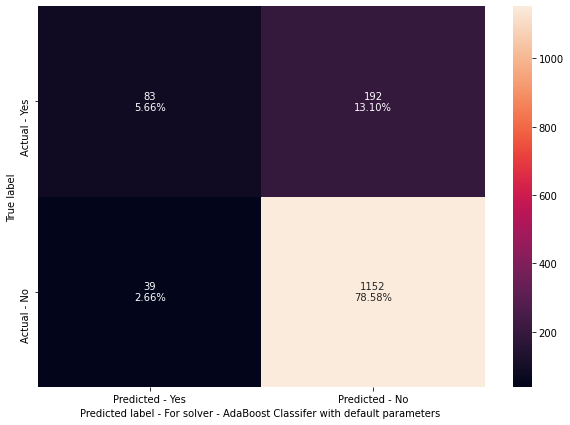

In [148]:
create_confusion_matrix(adaBoostClassifier ,X_test,y_test,classifierName)

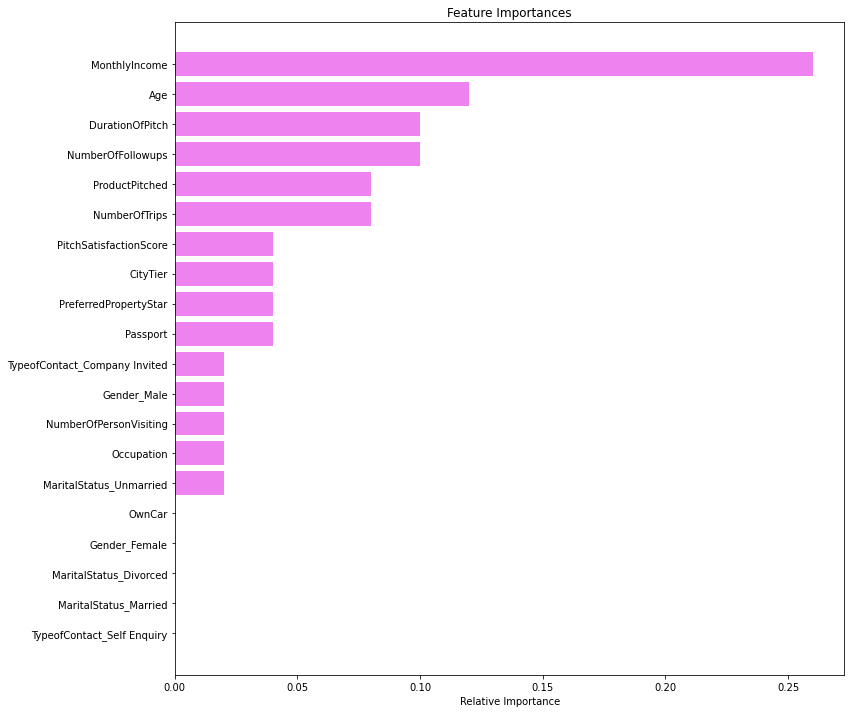

In [147]:
get_feature_importance(adaBoostClassifier, X_test.columns)

### Observations on AdaBoost Classifier with Default Parameters - Score, Confusion Matrix  & Feature Importance

- Accuracy on training dataset of .85 and .84 on testing dataset, indicates that Model isn't overfitting. 

- Recall on training is .37 but .30 on testing dataset. Recall score is pretty low, and doesn't make Adaboost a suitable model for us. 

- Precision on training dataset is .72 but on testing its 0.68. Again not great performance on accuracy.  

- There are lot more false negatives in the model, which is particularly bad of our use case, because that's the customers company wants to target. 

- Model did well enough to identify True Negatives, which is good for use case, since company wont target these customer base and save money.

- `MonthlyIncome`, `Age` and `DurationOfPitch` appears to be the top 3 features as per AdaBoost Classifier, while `TypeOfContact_Self Enquiry` , `Marital Status - Married & Divorced`, `Gender - Female` and `OwnCar` has absolutely no importance. 

***We got very less True Positive (TPR of 30%), but model did an excellent job of finding True Negatives. No Recall value is not good for our use case and hence this model shouldn't be use for use case.***

### Gradient Boosting Classifier without Hypertuning

Let's have a look at some of the default parameters of Gradient Boosting Classifier. 

- `loss`{‘deviance’, ‘exponential’}, default=’deviance’
- `learning_ratefloat`, default=0.1
- `n_estimatorsint`, default=100
- `subsamplefloat`, default=1.0
- `criterion{`‘friedman_mse’, ‘mse’, ‘mae’}, default=’friedman_mse’
- `min_samples_splitint or float`, default=2
- `min_samples_leafint or float`, default=1
- `initestimator` or ‘zero’, default=None

In [149]:
gradientBoostingClassifier = GradientBoostingClassifier(random_state=1)
gradientBoostingClassifier.fit(X_train, y_train)
models.append(gradientBoostingClassifier)

In [150]:
## Calculate Gradient Boosting Classifier model score using a Thresholds of 0.5

classifierName = "Gradient Boosting Classifier with default parameters "

gradientBoostClassifierScore = calculate_model_score(gradientBoostingClassifier, X_train, X_test, y_train, y_test, classifierName, threshold=0.5 )

Accuracy on training set using  :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.8909356725146199
Accuracy on test set using :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.8608458390177354
Recall on training set using :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.48989113530326595
Recall on test set using :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.3490909090909091
Precision on training set using :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.875
Precision on test set using :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.7933884297520661
F1 on training set using :  Gradient Boosting Classifier with default parameters   with threshold  0.5  is --  0.6281156530408774
F1 on test set using :  Gradient Boosting Classifier with default parameters   

Observations - 

1) Gradient Boosting Classifier gave a slightly better Recall compare to AdaBoot Classifer, but its still low. 

2) Model doesn't seem to overfit too much. 

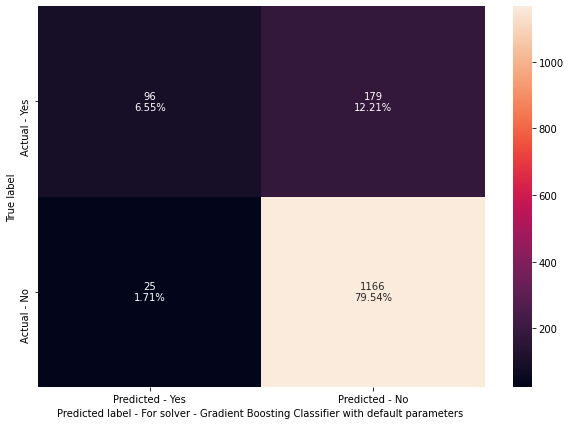

In [152]:
create_confusion_matrix(gradientBoostingClassifier ,X_test,y_test,classifierName)

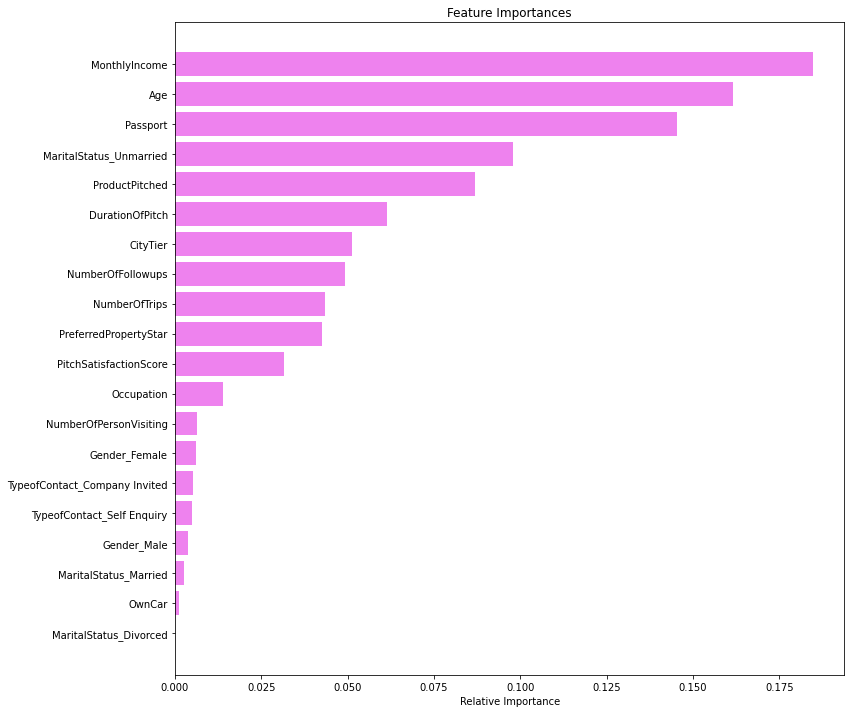

In [153]:
get_feature_importance(gradientBoostingClassifier, X_test.columns)

### Observations on GradientBoost Classifier with Default Parameters - Score, Confusion Matrix  & Feature Importance. 

- Accuracy on training dataset of .89 and .86 on testing dataset, indicates that Model isn't overfitting by lot.  

- Recall on training is .48 but .34 on testing dataset. Recall score is still low, although better than AdaBoost Classifier. 

- Precision on training dataset is .87 but on testing its 0.79. Again not great performance on accuracy.  

- There are lot more false negatives in the model, which is particularly bad of our use case, because that's the customers company wants to target. 

- Model did well enough to identify True Negatives, which is good for use case, since company wont target these customer base and save money.

- `MonthlyIncome`, `Age` and `Passport` are the top three important features, `MaritalStatus_Divorced', `OwnCar`, `MaritalStatus_Married` are the lest important features. 


***We got very less True Positive (TPR of 34.9%), but better than AdaBoost Classifier. Model did an execellent in identifying True Negatives, while keeping False Positives low.**

### Extreme Boosting(XGBoost) Classifier without Hypertuning

Let's have a look at some of the default parameters of XGBoost Classifier.

- `booster` 

- `nthread` default to set max number of available Threads.

- `eta` or `learning_rate` default=0.3

- `gamma` or `min_split_loss` default = 0

- `max_depth` default = 6

- `colsample_bytree`, `colsample_bylevel`, `colsample_bynode` default = 1

In [155]:
xgBoostClassifier = XGBClassifier(random_state=1, eval_metric='logloss')
xgBoostClassifier.fit(X_train,y_train)

models.append(xgBoostClassifier)

In [156]:
## Calculate Gradient Boosting Classifier model score using a Thresholds of 0.5

classifierName = "XGBoost Classifier with default parameters "

xgBoostClassifierScore = calculate_model_score(xgBoostClassifier, X_train, X_test, y_train, y_test, classifierName, threshold=0.5)

Accuracy on training set using  :  XGBoost Classifier with default parameters   with threshold  0.5  is --  1.0
Accuracy on test set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  0.927694406548431
Recall on training set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  1.0
Recall on test set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  0.6836363636363636
Precision on training set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  1.0
Precision on test set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  0.9082125603864735
F1 on training set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  1.0
F1 on test set using :  XGBoost Classifier with default parameters   with threshold  0.5  is --  0.7800829875518672
**********************************************************************************

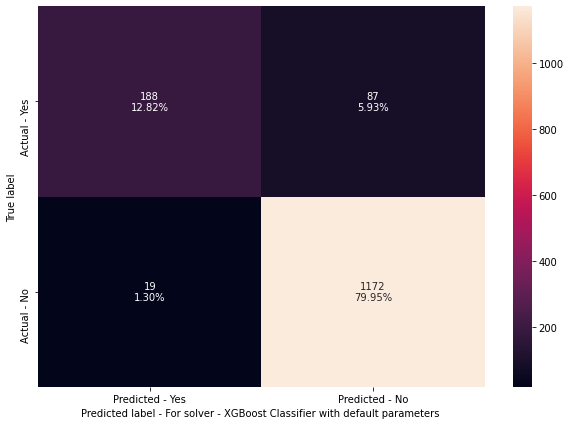

In [157]:
create_confusion_matrix(xgBoostClassifier ,X_test,y_test,classifierName)

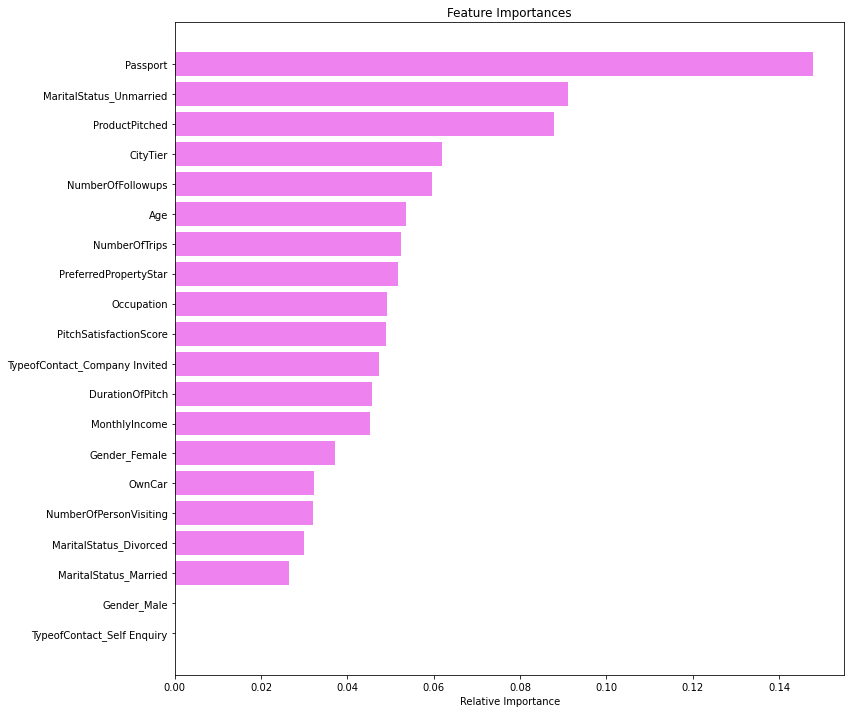

In [158]:
get_feature_importance(xgBoostClassifier, X_test.columns)

### Observations on XGBoost Classifier with Default Parameters - Score, Confusion Matrix .

- Accuracy on training dataset of 1 and .92 on testing dataset, indicates that Model is overfitting, which may not be bad. 

- Recall on training is 1 but .683 on testing dataset. Although the model overfitted, but its recall score on testing dataset is better.

- Precision on training dataset is 1 but on testing its 0.90. Model overfitted.  

- There are lot less (but still few) false negatives in the model. We will by tunning hyperparamters if this can be improved. 

- There are few False Positives (very low though) and that is expected since model did a slight overfitting. 

- Model did well enough to identify True Negatives, which is good for use case, since company wont target these customer base and save money.


***We got very higher True Positive (TPR of 68.3%), compare to other models so far. We will see if Hypertunning can get us any better results***

## Hyperparameter Tuning 

***Tuning Adaboost Classifer***

We will try various values of following parameters - 

- `base_estimator` with different `max_depth`
- ` n_estimators`
- `learning_rate`

In [159]:
# Build the classifier. 
adaBoostClassifer_tuned = AdaBoostClassifier(random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    #Let's try different max_depth for base_estimator
    "base_estimator":[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),DecisionTreeClassifier(max_depth=3),DecisionTreeClassifier(max_depth=4)],
    "n_estimators": np.arange(50,150,10),
     "learning_rate":np.arange(0.1,2,0.3)
}

adaBoostClassifer_tuned = getBestEstimatorUsingGridSearch(adaBoostClassifer_tuned, parameters, X_train,y_train)

In [160]:
#Using above defined function to get accuracy, recall and precision on train and test set
classifierName = "Tuned AdaBoost Classifier "

adaBoostClassifer_tuned_score= calculate_model_score(adaBoostClassifer_tuned, X_train, X_test, y_train, y_test, classifierName)

Accuracy on training set using  :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.997953216374269
Accuracy on test set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.8765347885402456
Recall on training set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.9937791601866252
Recall on test set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.6145454545454545
Precision on training set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.9953271028037384
Precision on test set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.6926229508196722
F1 on training set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.9945525291828794
F1 on test set using :  Tuned AdaBoost Classifier   with threshold  0.5  is --  0.651252408477842
************************************************************************************************************



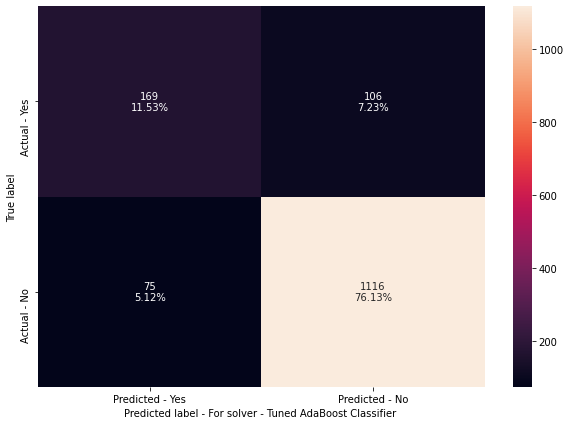

In [162]:
create_confusion_matrix(adaBoostClassifer_tuned,X_test,y_test, classifierName)

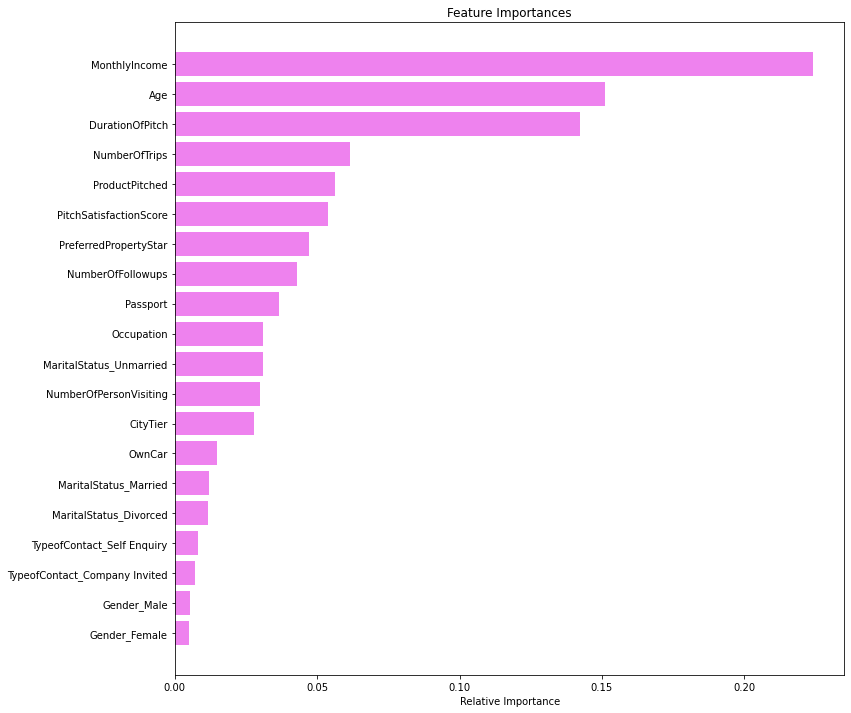

In [163]:
get_feature_importance(adaBoostClassifer_tuned, X_test.columns)

### Observations on AdaBoost Classifier with Tuned HyperParameters - Score, Confusion Matrix , Feature Importance. 

- Accuracy on training dataset of .99 and .87 on testing dataset, indicates that Model is overfitting. 

- Recall on training is 0.99 but .61 on testing dataset. Although the model overfitted, but its recall score on testing dataset is better than default AdaBoost Classifier

- Same trend is observed on precision as well. Precision on training dataset is .99 but on testing its 0.69. Model overfitted.  

- There are few false negatives in the model. This needs to be improved

- Model did well enough to identify True Negatives, which is good for use case, since company wont target these customer base and save money.

- 'MonthlyIncome`, `Age` and `DurationOfPitch` are the most important features and `Gender`, `TypeofContact` and `MaritalStatus` are found to be the least important features. 

***We got a higher True Positive (TPR of 61.45%), which is good but still lower than XGBoost Classifier***

### Gradient Boost Classifier with tunned Hyperparameters

- Most of the hyperparameters available are same as random forest classifier.
- init: An estimator object that is used to compute the initial predictions. If ‘zero’, the initial raw predictions are set to zero. By default, a DummyEstimator predicting the classes priors is used.
- There is no class_weights parameter in gradient boosting.

In [319]:
gradientBoostClassfier_init = GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1)
gradientBoostClassfier_init.fit(X_train,y_train)
models.append(gradientBoostClassfier_init)

GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                           random_state=1)

In [320]:
#Using above defined function to get accuracy, recall and precision on train and test set
classifierName = "Initial GradientBoostClassiifier"
gradientBoostClassfier_init_score=calculate_model_score(gradientBoostClassfier_init, X_train, X_test, y_train, y_test, classifierName)
create_confusion_matrix(gradientBoostClassifier_tuned,X_test, y_test,classifierName,threshold=0.5)
get_feature_importance(xgBoostClassifier_tuned, X_test.columns)

Accuracy on training set using  :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.8909356725146199
Accuracy on test set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.8608458390177354
Recall on training set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.48055987558320373
Recall on test set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.3490909090909091
Precision on training set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.8879310344827587
Precision on test set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.7933884297520661
F1 on training set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.6236125126135218
F1 on test set using :  Initial GradientBoostClassiifier  with threshold  0.5  is --  0.48484848484848486
***********************************************************************************************************

In [321]:
# Choose the type of classifier. 
gradientBoostClassifier_tuned = GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1)

# Grid of parameters to choose from
## add from article
parameters = {
    "n_estimators": [100,150,200,250],
    "subsample":[0.8,0.9,1],
    "max_features":[0.7,0.8,0.9,1]
}

gradientBoostClassifier_tuned = getBestEstimatorUsingGridSearch(gradientBoostClassifier_tuned, parameters, X_train,y_train)


GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),
                           max_features=0.9, n_estimators=250, random_state=1,
                           subsample=0.8)

In [323]:
#Using above defined function to get accuracy, recall and precision on train and test set
classifierName = "Tuned GradientBoostClassiifier"
gradientBoostClassifier_tuned_score=calculate_model_score(gradientBoostClassifier_tuned, X_train, X_test, y_train, y_test, classifierName)

Accuracy on training set using  :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.928654970760234
Accuracy on test set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.8765347885402456
Recall on training set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.6656298600311042
Recall on test set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.45454545454545453
Precision on training set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.936542669584245
Precision on test set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.8012820512820513
F1 on training set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.7781818181818182
F1 on test set using :  Tuned GradientBoostClassiifier  with threshold  0.5  is --  0.580046403712297
************************************************************************************************************



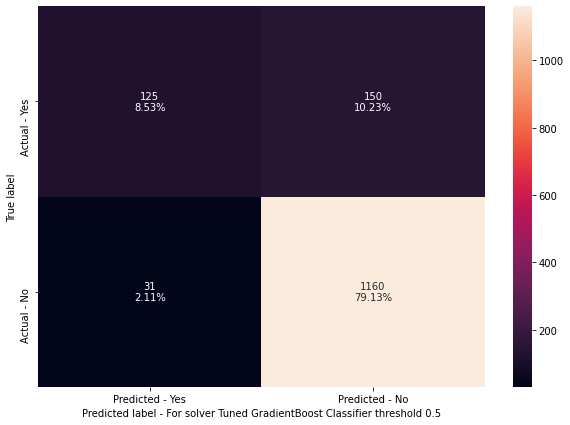

In [324]:
create_confusion_matrix(gradientBoostClassifier_tuned,X_test,y_test,classifierName,threshold=0.5)

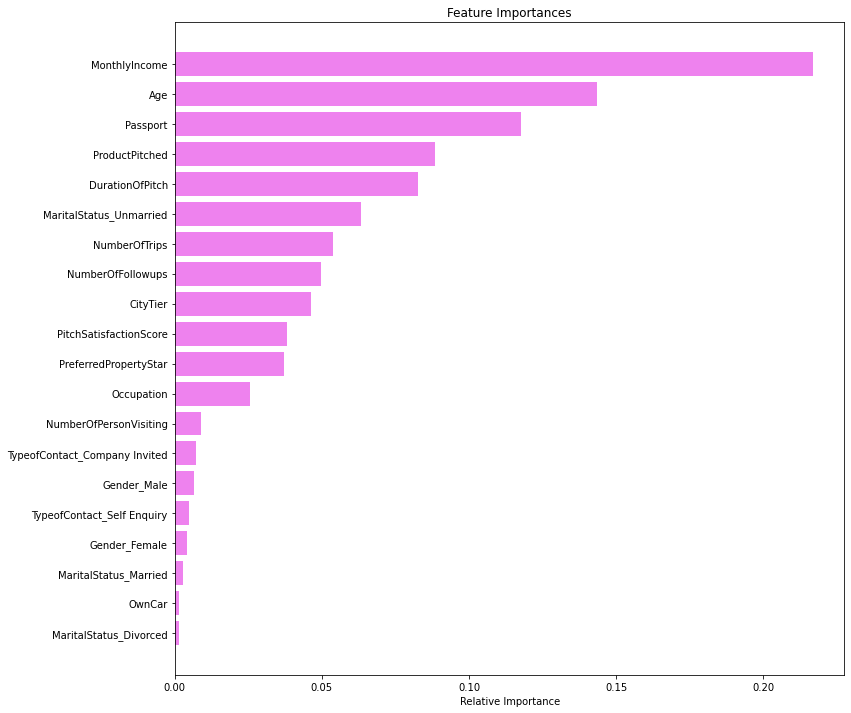

In [325]:
get_feature_importance(gradientBoostClassifier_tuned, X_test.columns)

### Observations on Initial GradientBoost with Tuned HyperParameters - Score, Confusion Matrix , Feature Importance. 

- Accuracy on training dataset of .92 and .87 on testing dataset, indicates that Model overfitted but only slightly. 

- Recall on training is 0.66 but .45 on testing dataset. Recall value is still very low. 

- Same trend is observed on precision as well. Precision on training dataset is .93 but on testing its 0.80. Model overfitted.  

- There are lot of false negatives in the model. This makes it a bad model. 

- Model did well enough to identify True Negatives, which is good for use case, since company wont target these customer base and save money.

- 'MonthlyIncome`, `Age` and `Passport` are the most important features and `MaritalStatus`, `OwnCar` and `Gender` are found to be the least important features. 

***We got a low True Positive (TPR of 45.45%), which is not good and we can't use this model***

### XGBoost Classifier with Hyperparameters Tuned

**XGBoost has many hyper parameters which can be tuned to increase the model performance. Some of the important parameters are:**
- scale_pos_weight:Control the balance of positive and negative weights, useful for unbalanced classes. It has range from 0 to $\infty$.
- subsample: Corresponds to the fraction of observations (the rows) to subsample at each step. By default it is set to 1 meaning that we use all rows.
- colsample_bytree: Corresponds to the fraction of features (the columns) to use.
- colsample_bylevel: The subsample ratio of columns for each level. Columns are subsampled from the set of columns chosen for the current tree.
- colsample_bynode: The subsample ratio of columns for each node (split). Columns are subsampled from the set of columns chosen for the current level.
- max_depth: is the maximum number of nodes allowed from the root to the farthest leaf of a tree.
- learning_rate/eta: Makes the model more robust by shrinking the weights on each step.
- gamma: A node is split only when the resulting split gives a positive reduction in the loss function. Gamma specifies the minimum loss reduction required to make a split.

In [326]:
##**Note** I initially run this without providing eval_metric as parameter. Which casused a lot of warning
##messages. But the results are available if you scroll down well enough. Since this is an extremely long running
##process (in access of 4 hours), I am not giving it another try.

# Create the classifier. 
classifierName = "Tuned XGBoostClasifier"
xgBoostClassifier_tuned = XGBClassifier(random_state=1,eval_metric='logloss')

# Define Parameters to tune
parameters = {
    "n_estimators": np.arange(10,100,20),
    "scale_pos_weight":[0,1,2,5],
    "subsample":[0.5,0.7,0.9,1],
    "learning_rate":[0.01,0.1,0.2,0.05],
    "gamma":[0,1,3],
    "colsample_bytree":[0.5,0.7,0.9,1],
    "colsample_bylevel":[0.5,0.7,0.9,1],
    "colsample_bynode":[0.5,0.7,0.9,1]
}

xgBoostClassifier_tuned = getBestEstimatorUsingGridSearch(xgBoostClassifier_tuned, parameters, X_train,y_train)


[02:32:15] WARNING: ../src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:32:15] WARNING: ../src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:32:15] WARNING: ../src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[02:32:15] WARNING: ../src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old be

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [327]:
#Using above defined function to get accuracy, recall and precision on train and test set
xgBoostClassifier_tuned_score=calculate_model_score(xgBoostClassifier_tuned, X_train, X_test, y_train, y_test, classifierName)

Accuracy on training set using  :  Tuned XGBoostClassiifier  with threshold  0.5  is --  1.0
Accuracy on test set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  0.927694406548431
Recall on training set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  1.0
Recall on test set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  0.6836363636363636
Precision on training set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  1.0
Precision on test set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  0.9082125603864735
F1 on training set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  1.0
F1 on test set using :  Tuned XGBoostClassiifier  with threshold  0.5  is --  0.7800829875518672
************************************************************************************************************



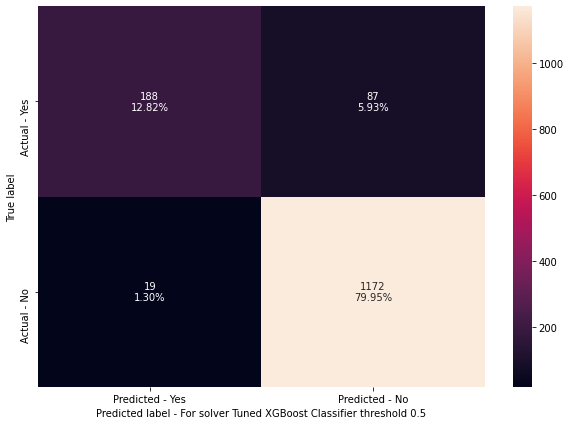

In [328]:
classifierName = "Tuned XGBoost Classifier"
create_confusion_matrix(xgBoostClassifier_tuned,X_test, y_test,classifierName,threshold=0.5)

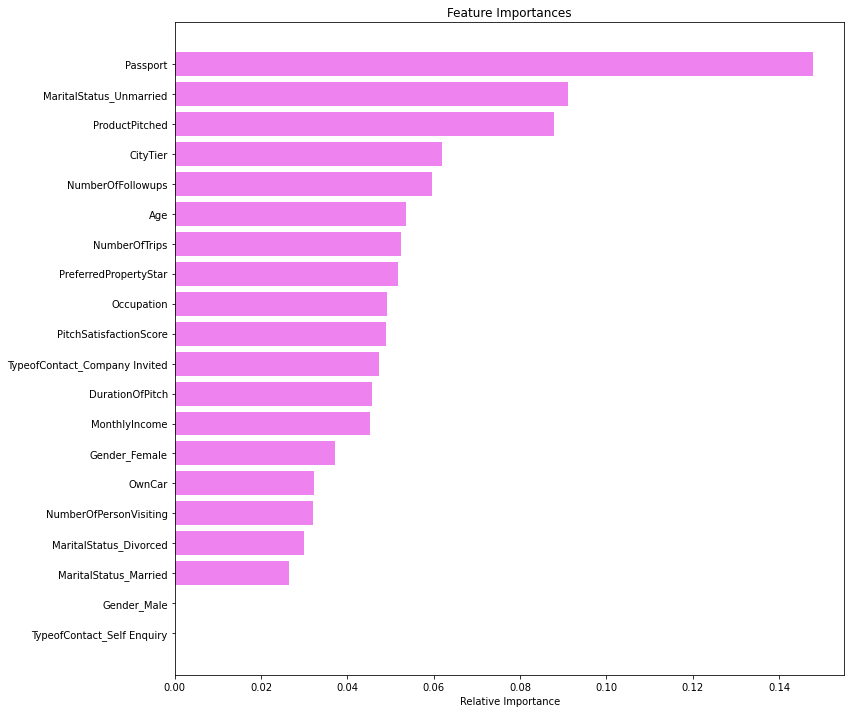

In [330]:
get_feature_importance(xgBoostClassifier_tuned, X_test.columns)

### Observations on XGBoost Classifiers with Tuned HyperParameters - Score, Confusion Matrix , Feature Importance. 

- Accuracy on training dataset of 1 and .92 on testing dataset, indicates that Model overfitted. 

- Recall on training is 1 but .6836 on testing dataset. Recall value is good. 

- Precision on training dataset is 1 but on testing its 0.90. Model overfitted.  

- There are fewer false negatives in the model. This makes it a good model. 

- Model did well enough to identify True Negatives, which is good for use case, since company wont target these customer base and save money.

- `Passport`, `MaritalStatus_Unmarried` and `ProductPitched` are the most important features and `TypeofContact_SelfEnquiry`, `Gender_Male` and `MaritalStatus_Married` are found to be the least important features. 
This is also in inline with the initial EDA findings. 

***We got a higher True Positive (TPR of 68.36%), which is not super high, but still best among all the models so far***

### 9) Boosting Classifiers - Performance Evaluation  

In [340]:
# defining list of models
boostingModels = [adaBoostClassifier, adaBoostClassifer_tuned, gradientBoostingClassifier, gradientBoostClassfier_init, gradientBoostClassifier_tuned, xgBoostClassifier, xgBoostClassifier_tuned]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []

# looping through all the models to get the accuracy, precall and precision scores
for model in Models:
    j = calculate_model_score(model, X_train, X_test, y_train, y_test, "",flag=False)
    acc_train.append(np.round(j[0],2))
    acc_test.append(np.round(j[1],2))
    recall_train.append(np.round(j[2],2))
    recall_test.append(np.round(j[3],2))
    precision_train.append(np.round(j[4],2))
    precision_test.append(np.round(j[5],2))

In [341]:
comparison_frame = pd.DataFrame({'Model':['AdaBoost with default paramters','AdaBoost Tuned', 
                                          'Gradient Boosting with default parameters','Gradient Boosting with init=AdaBoost',
                                          'Gradient Boosting Tuned','XGBoost with default parameters','XGBoost Tuned'], 
                                          'Train_Accuracy': acc_train,'Test_Accuracy': acc_test,
                                          'Train_Recall':recall_train,'Test_Recall':recall_test,
                                          'Train_Precision':precision_train,'Test_Precision':precision_test}) 
comparison_frame

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision
0,AdaBoost with default paramters,0.86,0.84,0.38,0.30,0.72,0.68
1,AdaBoost Tuned,1.00,0.88,0.99,0.61,1.00,0.69
2,Gradient Boosting with default parameters,0.89,0.86,0.49,0.35,0.88,0.79
3,Gradient Boosting with init=AdaBoost,0.89,0.86,0.48,0.35,0.89,0.79
4,Gradient Boosting Tuned,0.93,0.88,0.67,0.45,0.94,0.80
5,XGBoost with default parameters,1.00,0.93,1.00,0.68,1.00,0.91
6,XGBoost Tuned,1.00,0.93,1.00,0.68,1.00,0.91


### What Metrics to look for ?

I have already explained in Bagging section on which Metrics are most important and why for this problem statement. Same holds true for Boosting Mechanism as well. 

`True Positive Rate` (`TPR` or `Recall`) is the most important metrics and should be as high as possible. At the same time `True Negative Rate` (`TNR` or `Specificity`) should be high as well. 

But between `TPR` & `Specificity`, I would prfer a model that gives a higher `TPR` at a cost of for slightly degraded `Specificity`.

**Evaluating Performance of various Bagging Classifiers.**

- XGBoot Classifiers gave the best performance ( high TPR & high TNR)
- Tuned XGBoostClassifier & XGBoostClassifier performed almost identical as seen above. 
- Gradient Boosting classifier see an increase in the performance after Hyper Tunning. But TPR still is quite low.
- AdaBoost saw a significant improvement after tuning Hyperparameter
- RandomForest with default parameters did well compare to Tuned Classifier and with class_weight. But still Bagging gave the best results.

**Best Boosting Classifier.**

  Looking at the performance metrics, it looks like Tuned XGBoost Classifier & untunned XGBoost classifier gave very similar results. Their TPR (or Recall) was highest among all other models (0.68). Their True Negative Rate was more than 98%. But for the computational saving I would recommend using untunned XGBoost (with default Hyperparameters). Computational cost of Tunned XGBoost is significantly higher, while its results are very similar to untunned XGBoost classifier. 


**Can we get a better model ?**

We have seen results from various Bagging & Boosting classifiers and tunned their various Hyperparameters. XGBoot with default Hyperparameters appears to be the best model among all. 

With homogenius models (both Bagging & Boosting are homogenous in nature, where they work on same classifier), this would be best results we can achieve. 

However we can make the model Hetrogenous by stacking different models on top of each other with final classifier to do the prediction. This mechanism is called Stacking. 

## Stacking 

For Stacking regressor, I am using XGBRegressor, LGBMRegressor & RandomForestRegressor with defaults parameters. 

I am using 2 Fold Stacking. In the first fold (or stage), I am using above 3 regressors and second fold I will be using XGBoostClassifier as meta-learner.

In [169]:
xgb = XGBRegressor()
lgbm = LGBMRegressor()
rf = RandomForestRegressor()

svr = SVR(kernel='linear')

stack = StackingCVRegressor(regressors=(rf, lgbm, xgb),
                            meta_regressor=xgb, cv=12,
                            use_features_in_secondary=True,
                            store_train_meta_features=True,
                            shuffle=False,
                            random_state=1)

stack.fit(X_train, y_train)
pred = stack.predict(X_test)
score = r2_score(y_test, pred)

In [167]:
print(score)

0.6093481747805795


**What is R^2 score ?**
R-Squared is a statistical measure of fit that indicates how much variation of a dependent variable is explained by the independent variable(s) in a regression model.

This stacking model explains upto 60% of the variance in the data. 

In [171]:
for model, label in zip([rf, lgbm, xgb, stack], ['RandomForest', 'LightGBM', 
                                                'XGB', 
                                                'StackingCVRegressor']):
    scores = cross_val_score(model, X_test, y_test, cv=5)
    print("R^2 Score: %0.2f (+/- %0.2f) [%s]" % (
        scores.mean(), scores.std(), label))

R^2 Score: 0.30 (+/- 0.06) [RandomForest]
R^2 Score: 0.23 (+/- 0.07) [LightGBM]
R^2 Score: 0.27 (+/- 0.08) [XGB]
R^2 Score: 0.19 (+/- 0.06) [StackingCVRegressor]


**Observation -** 
R^2 Score for the regressor is 0.19. Which is very low. This model only explains 20% of the variance in the data. 

In [174]:
ridge = Ridge(random_state=1)
lasso = Lasso(random_state=1)
rf = RandomForestRegressor(random_state=1)

stack = StackingCVRegressor(regressors=(lasso, ridge),
                            meta_regressor=rf, 
                            random_state=1,
                            use_features_in_secondary=True)

params = {'lasso__alpha': [0.1, 1.0, 10.0],
          'ridge__alpha': [0.1, 1.0, 10.0]}

getBestEstimatorUsingGridSearch


grid = GridSearchCV(
    estimator=stack, 
    param_grid={
        'lasso__alpha': [x/5.0 for x in range(1, 10)],
        'ridge__alpha': [x/20.0 for x in range(1, 10)],
        'meta_regressor__n_estimators': [10, 100]
    }, 
    cv=5,
    refit=True
)

grid_obj = grid.fit(X_train, y_train)



print("Best: %f using %s" % (grid.best_score_, grid.best_params_))

Best: 0.467849 using {'lasso__alpha': 0.6, 'meta_regressor__n_estimators': 100, 'ridge__alpha': 0.4}


The best R^2 score is found to be 0.46 or the best model can explaine 46% of the variance in the data. 

## 10) Key Insights and Business Recommendatins 

Based on the results from various Bagging & Boosting models we created above, XGBoosting gave the best results and is best suited for the problem statement. 

The best Recall value we got is 0.68 and True Negative rate of 98%. Extremely high True Negative rate is good metrics for the company as they get a clear idea about the customer bases that have probability of buying vs not buying the product and can create strategies to cater each of the customer base. 

Passport, Marital Status of Unmarried (both Single and Unmarried) and product pitch are very important features of Customers, while Self Enquiry, Marital Status of Married & Divorced are least important features.

**Recommendations to Marketing Team :-**


1) Customers with Passport have higher probabilities of buying the Travel Product. Company should provide complimentory Passport assistance service to customers or create bundle services, in lieu of increasing their chances of buying a Travel Package. 

2) Company should pitch about their packages customers with Passport.

3) As seen from the data, Product Pitch is an important feature. But as per the data, it seems company only pitch 1 package to 1 class of customers (based on their Designation or Occupation). So if customer's need aren't completely met in the pitched product, they have no option. Company should revisit this strategy and provide multiple packages to customers. 

4) As seen clear from the EDA and also confirmed in the model Type Of Product makes a positive difference in probablity of customer buying the product. However only 30% of customers were reached by the company, other 70% did self enquiry. Company should reach out to more customer base, specially the one with Passport, Unmarried customers. 

5) Most of the customers resides in Tier 1 & Tier 3 cities. However small number of customers present in Tier 2 have higher percentage of buying a product. Hence company should reach out customers from Tier 2 cities. 

6) Younger population (less than 21 years of age) have very high probablities of buying a product. Company should target young customers to pitch their products. Company can be combine customer's age, along with those having passport, unmarried and from Tier 2 cities. 

7) Customers with small children under 5 years of age is very fairly distributed, yet the conversion rate of those customer aren't high. Company should foucs on families with smaller children and include their needs in their package and highlight those during the pitch. 

8) Customers those preferred 5 star hotels have very high coversion rate (26%), while its low for customers that prefer 3 star & 4 star hotel. There is also a correlation to draw here with their Monthly Salary. Company should run discounts on 5 star hotels to expand its customer base to lower income group. Also company might want to expand 3 & 4 star hotel selection and bundle that with complimentaty meals or activities for the prices conscious customers.

9) Duration of Pitch has a postive impact on the conversion rate of the customers. Company should revisit their Pitch to be right duration with right content and train their salesperson to be effective and elegant while delevering pitch to customers. 